<a href="https://colab.research.google.com/github/askolesov0608/SJK0015/blob/main/chap11_FIN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Robotics, Vision & Control 3e: for Python
## Chapter 11: Images & Image processing

Copyright (c) 2021- Peter Corke

In [ ]:
try:
    import google.colab
    print('Running on CoLab')
    !pip install matplotlib
    !pip install machinevision-toolbox-python
    COLAB = True
except:
    COLAB = False

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "last_expr_or_assign"
!pip install ipympl
%matplotlib widget
import numpy as np

import matplotlib.pyplot as plt
import math
from math import pi
from os import getenv
np.set_printoptions(
    linewidth=120, formatter={
        'float': lambda x: f"{0:8.4g}" if abs(x) < 1e-10 else f"{x:8.4g}"})
np.random.seed(0)
from machinevisiontoolbox.base import *
from machinevisiontoolbox import *
from spatialmath.base import *
from spatialmath import SE2, Twist2


Running on CoLab
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 238.0/238.0 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.9/184.9 kB 21.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.7/128.7 MB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 72.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.2/204.2 kB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 48.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.9/98.9 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 48.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 37.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 468

# 11.1 Obtaining an Image
## 11.1.1 Images from Files


In [ ]:
import matplotlib.image as mpimg
from google.colab import output
output.enable_custom_widget_manager()


In [ ]:
street, _ = iread("street.png");

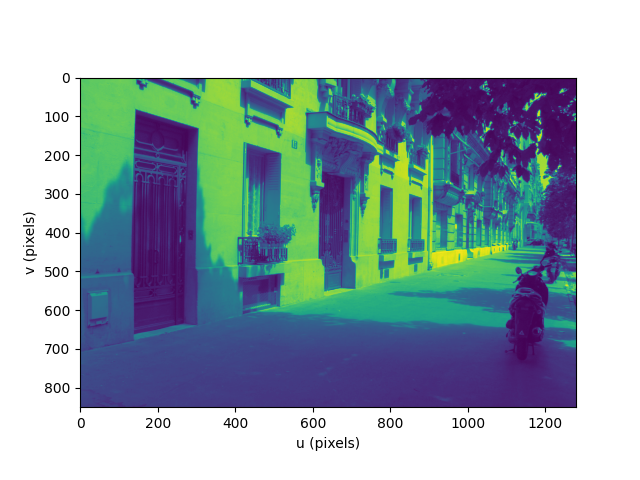

In [ ]:
plt.imshow(street)
plt.axis('on')  #off Убрать оси для чистого отображения изображения
plt.show()

In [ ]:
street

array([[193, 193, 191, ...,   8,   7,   6],
       [189, 190, 191, ...,   7,   7,   8],
       [190, 189, 190, ...,   8,   8,   7],
       ...,
       [ 50,  51,  52, ...,  30,  28,  29],
       [ 53,  54,  53, ...,  28,  28,  29],
       [ 53,  56,  54, ...,  27,  27,  28]], dtype=uint8)

In [ ]:
street.shape

(851, 1280)

In [ ]:
street[400, 200]

24

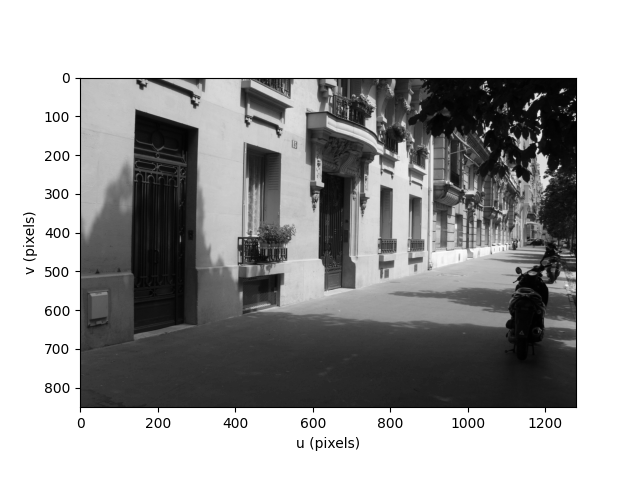

In [ ]:
idisp(street); #для отображения изображения

In [ ]:
flowers, _ = iread("flowers8.png")

In [ ]:
flowers.dtype

dtype('uint8')

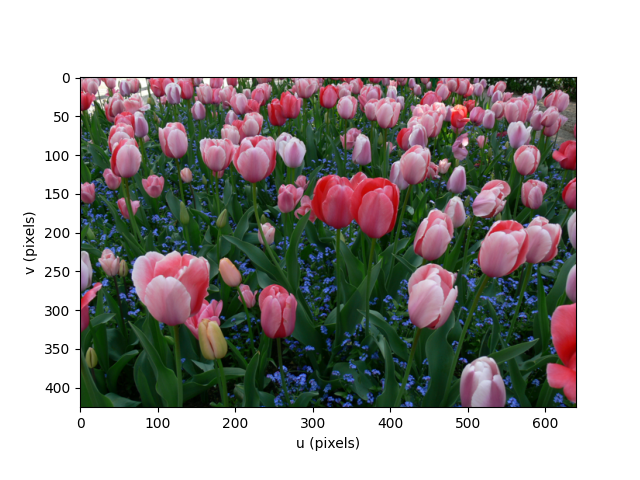

In [ ]:
idisp(flowers);

In [ ]:
flowers.shape

(426, 640, 3)

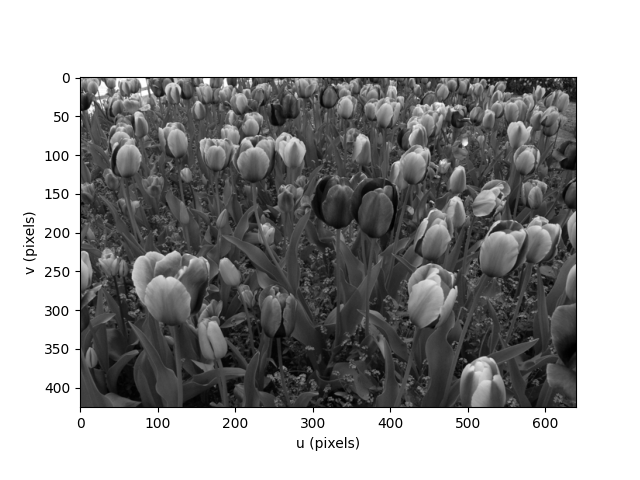

In [ ]:
idisp(flowers[:, :, 0]);

In [ ]:
pix = flowers[276, 318, :]

array([ 77, 109, 218], dtype=uint8)

In [ ]:
street = Image.Read("street.png")

Image: 1280 x 851 (uint8) [.../images/street.png]

In [ ]:
street.shape

(851, 1280)

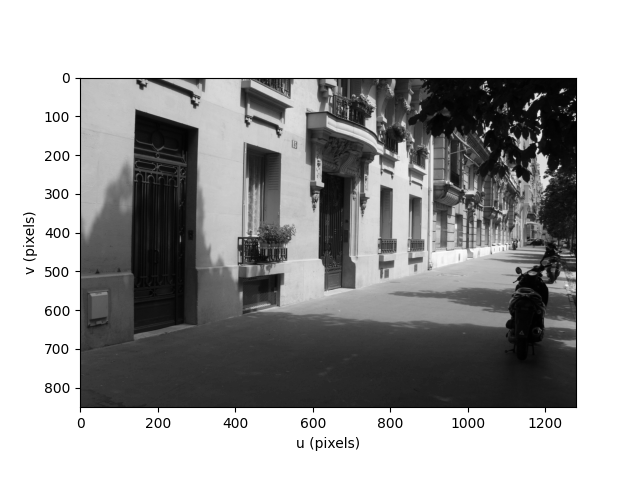

In [ ]:
street.disp();

In [ ]:
street.min()


0

In [ ]:
street.max()

255

In [ ]:
street.stats()

range=0 - 255, mean=92.431, sdev=70.340


In [ ]:
img = street.image;
type(img)

numpy.ndarray

In [ ]:
street.image[400, 200]

24

In [ ]:
subimage = street.image[100:200, 200:300]; #Доступ к элементам и подмассивам
type(subimage)

numpy.ndarray

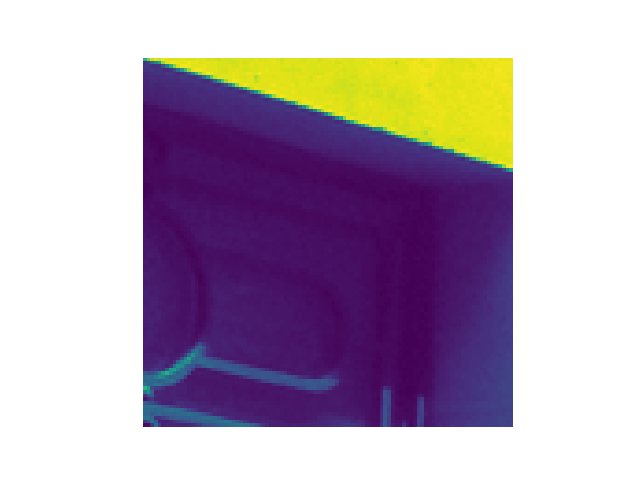

In [ ]:
plt.imshow(subimage)
plt.axis('off')  # Отключить отображение осей
plt.show()

In [ ]:
subimage = street[100:200, 200:300];
type(subimage)

machinevisiontoolbox.ImageCore.Image

In [ ]:
plt.imshow(subimage)
plt.axis('off')  # Отключить отображение осей
plt.show()

TypeError: Image data of dtype object cannot be converted to float

In [ ]:
flowers = Image.Read("flowers8.png")

Image: 640 x 426 (uint8), R:G:B [.../images/flowers8.png]

In [ ]:
flowers.metadata()

In [ ]:
flowers.stats()

R: range=0 - 255, mean=83.346, sdev=74.197
G: range=0 - 255, mean=77.923, sdev=42.822
B: range=0 - 255, mean=72.085, sdev=61.307


In [ ]:
flowers.image[276, 318, :]

array([ 77, 109, 218], dtype=uint8)

In [ ]:
flowers.image[:, :, 0];

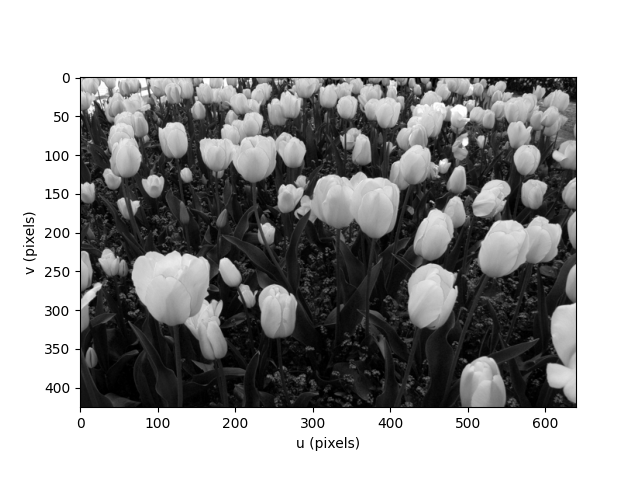

In [ ]:
flowers[:, :, 0].disp();

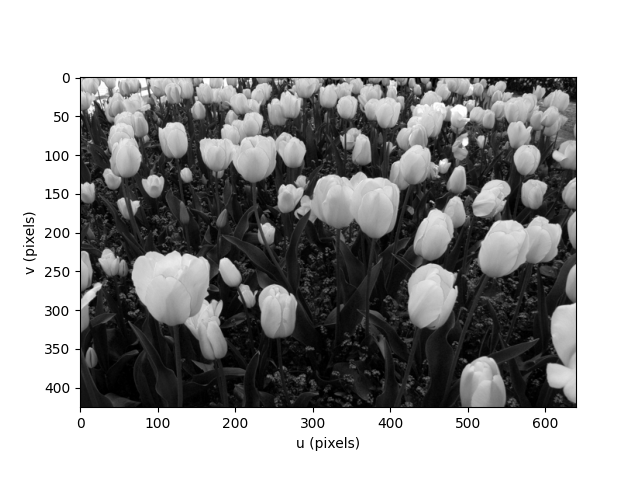

In [ ]:
flowers.plane(0).disp();

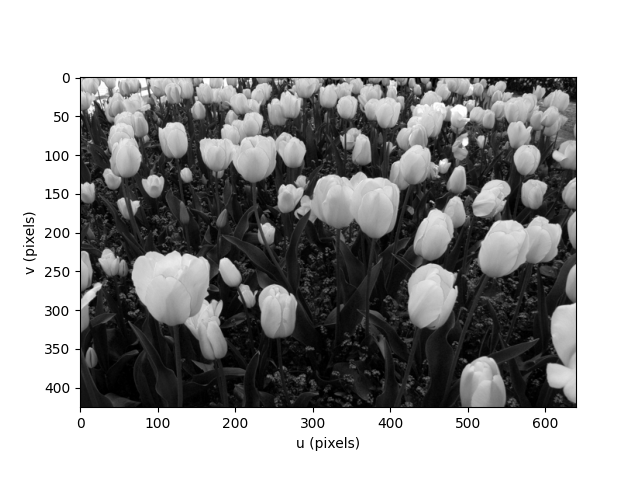

In [ ]:
flowers.plane("R").disp();

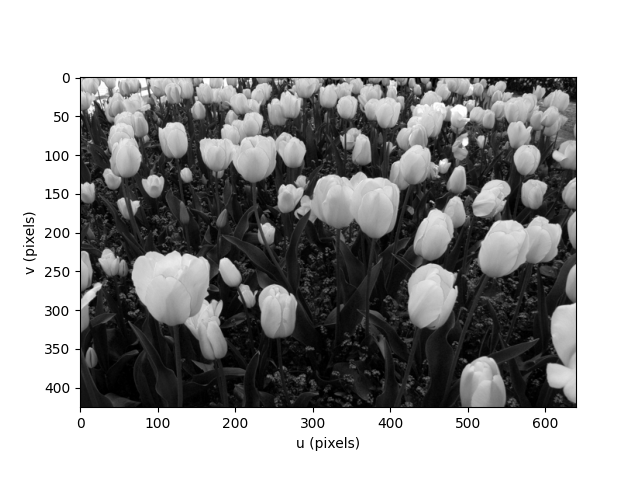

In [ ]:
flowers.red().disp();

In [ ]:
flowers.plane("B:R:G")

Image: 640 x 426 (uint8), B:R:G

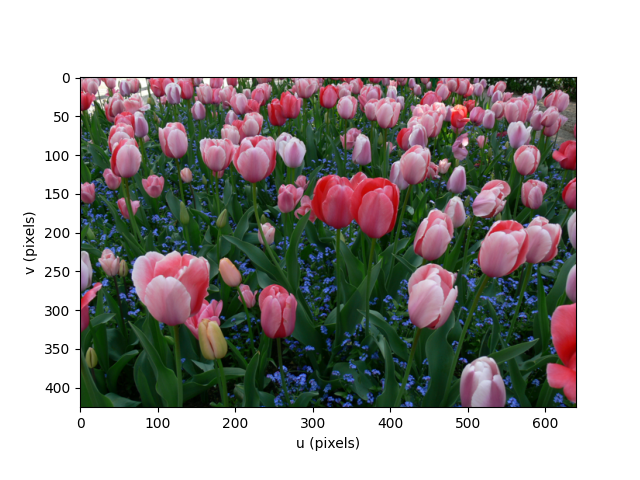

In [ ]:
flowers.plane("B:G:R").disp();

In [ ]:
church = Image.Read("church.jpg");
church.metadata()

{'ResolutionUnit': 2,
 'ExifOffset': 188,
 'Make': 'Panasonic',
 'Model': 'DMC-FZ30',
 'Software': 'Ver.1.0  ',
 'Orientation': 1,
 'DateTime': '2009:08:22 15:50:06',
 'XResolution': 72.0,
 'YResolution': 72.0,
 'ExifVersion': b'0220',
 'FlashPixVersion': b'0100',
 'CompressedBitsPerPixel': 4.0,
 'DateTimeOriginal': '2009:08:22 15:50:06',
 'DateTimeDigitized': '2009:08:22 15:50:06',
 'ExposureBiasValue': 0.0,
 'MaxApertureValue': 3.0,
 'MeteringMode': 5,
 'LightSource': 0,
 'Flash': 16,
 'FocalLength': 7.4,
 'ColorSpace': 1,
 'ExifImageWidth': 1280,
 'DigitalZoomRatio': 0.0,
 'FocalLengthIn35mmFilm': 37,
 'SceneCaptureType': 0,
 'ExifImageHeight': 851,
 'Contrast': 0,
 'Saturation': 0,
 'Sharpness': 0,
 'SensingMethod': 2,
 'ExposureTime': 0.0025,
 'FNumber': 8.0,
 'ExposureProgram': 2,
 'CustomRendered': 0,
 'ISOSpeedRatings': 80,
 'ExposureMode': 0,
 'WhiteBalance': 0,
 'GainControl': 0}

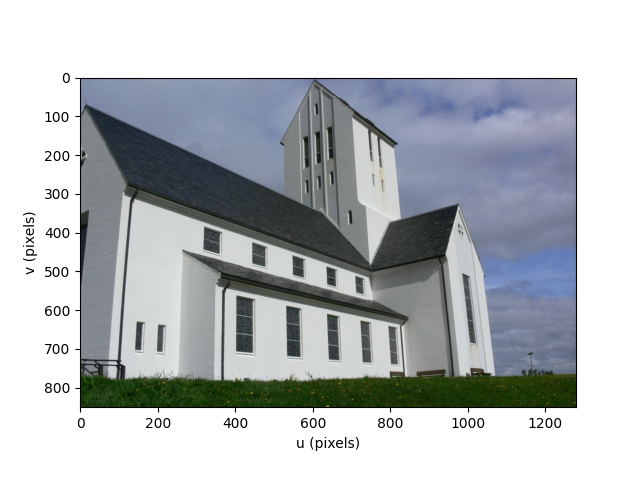

In [ ]:
church.plane("B:G:R").disp();

## 11.1.2 Images from File Sequences


In [ ]:
images = ImageCollection("seq/*.png");
len(images)

9

In [ ]:
images[3]

Image: 512 x 512 (uint8), id=3 [.../seq/im.004.png]

Использован атрибут 'image' для получения данных изображения.


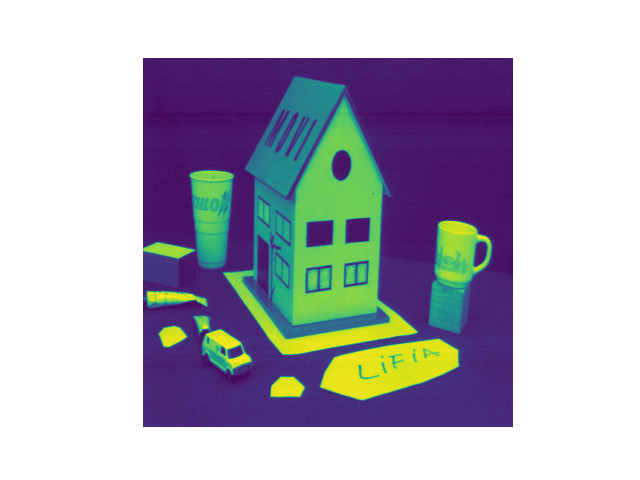

In [ ]:
# Пытаемся извлечь массив пикселей из объекта изображения
# Предполагаем, что объект изображения имеет атрибут, возвращающий массив NumPy, например, .image или .data
# Вы должны заменить .image на правильный атрибут или метод, соответствующий вашему объекту
if hasattr(images[3], 'image'):
    pixel_array = images[3].image
    print("Использован атрибут 'image' для получения данных изображения.")
else:
    pixel_array = images[3].data
    print("Атрибут 'image' отсутствует. Использован атрибут 'data' для получения данных изображения.")


plt.imshow(pixel_array)
plt.axis('off')  # Скрыть оси для более чистого вида изображения
plt.show()

<div style="background-color:red">
<span style="background-color:red; font-size:20pt">NOTE</span>

The commented out code below produces an animation for a Python script, however, using Jupyter produces a set of separate images.  Use OpenCV instead (`matplotlib=False`) to display the animation in a separate window.
</div>

<ipython-input-121-af753cc691c2>:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 5))  # figsize можно адаптировать под ваш экран


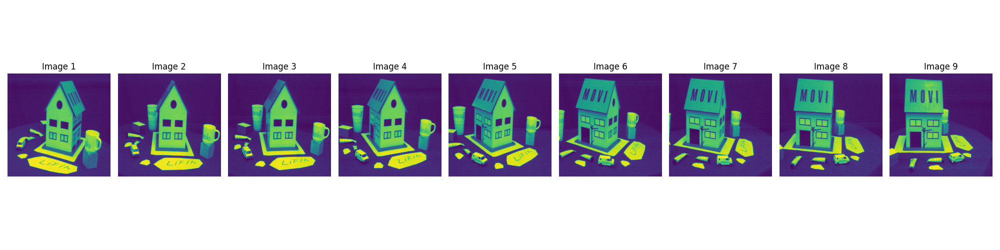

In [ ]:
# Определяем количество строк и столбцов для субплотов
# В данном случае выводим все изображения в один ряд
nrows = 1
ncols = len(images)  # Количество изображений

# Создаем фигуру и массив осей для субплотов
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 5))  # figsize можно адаптировать под ваш экран

# Проходим по всем изображениям и их соответствующим осям в цикле
for idx, ax in enumerate(axes):
    # Извлекаем изображение
    img = images[idx].image if hasattr(images[idx], 'image') else images[idx].data
    # Отображаем изображение в текущем субплоте
    ax.imshow(img)
    ax.axis('off')  # Скрываем оси
    ax.set_title(f'Image {idx+1}')  # Называем каждый субплот

plt.tight_layout()  # Улучшаем расположение субплотов
plt.show()  # Выводим все субплоты


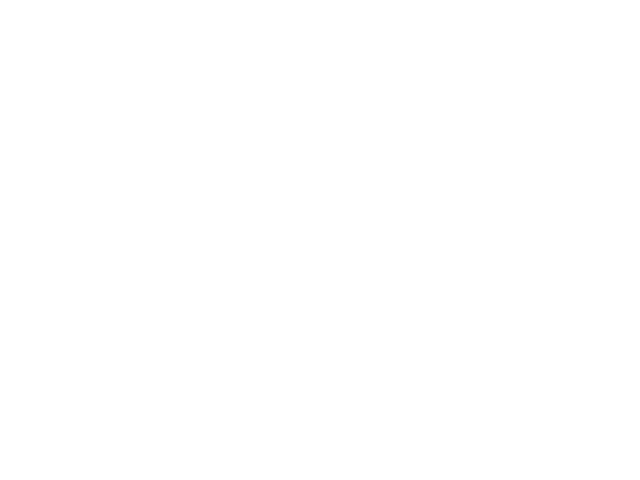

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Функция для обновления каждого кадра анимации
def update(frame):
    plt.clf()  # Очищаем текущий кадр перед отрисовкой следующего
    img = images[frame].image if hasattr(images[frame], 'image') else images[frame].data
    plt.imshow(img)
    plt.axis('off')  # Скрываем оси

# Создаем фигуру для анимации
fig = plt.figure()

# Создаем анимацию, используя FuncAnimation
ani = FuncAnimation(fig, update, frames=len(images), repeat=False)

plt.show()


In [ ]:
ani.save('animation.mp4', writer='ffmpeg', fps=2)  # fps контролирует скорость воспроизведения кадров

In [ ]:
from IPython.display import HTML
from base64 import b64encode

video_path = 'animation.mp4'
mp4 = open(video_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
# for image in images:
#   image.disp(reuse=True, fps=5)  # do some operation

# use OpenCV instead
if COLAB:
  print("this example cannot run with CoLab")
else:
  for image in images:
    image.disp(title="sequence", reuse=True, fps=5, matplotlib=False)  # do some operation

  # type 'q' in the image animation window to close it
  cv_destroy_window("sequence", block=False)

this example cannot run with CoLab


<div style="background-color:red">
<span style="background-color:red; font-size:20pt">NOTE</span>

The example below requires that you have downloaded the extra image data, [see these instructions](https://github.com/petercorke/machinevision-toolbox-python/blob/master/mvtb-data/README.md#install-big-image-files).  These files will not be installed by default when you run on CoLab.
</div>

In [ ]:
if not COLAB:
    images = ZipArchive("bridge-l.zip", "*.pgm");
    len(images)

## 11.1.3 Images from an Attached Camera


In [ ]:
if COLAB:
    print("there is no camera available in the Colab environment")
else:
    camera = VideoCamera(0)
    image = camera.grab()
    camera.release()
    image.disp()

there is no camera available in the Colab environment


## 11.1.4 Images from a Video File


In [ ]:
video = VideoFile("traffic_sequence.mp4")

VideoFile(traffic_sequence.mp4) 704 x 576, 350 frames @ 30fps

In [ ]:
video.shape

(576, 704, 3)

<div style="background-color:red">
<span style="background-color:red; font-size:20pt">NOTE</span>

The commented out code produces an animation for a Python script, however, using Jupyter produces a set of separate images.  Use OpenCV instead (`matplotlib=False`) to display the animation in a separate window.
</div>

In [ ]:
# for frame in video:
#   frame.disp(reuse=True, fps=video.fps) # display frame in the same axes

# use OpenCV instead
if COLAB:
  print("this example cannot run with CoLab")
else:
  for frame in video:
    frame.disp(title="intersection", reuse=True, fps=video.fps, matplotlib=False) # display frame in the same axes
    # type 'q' in the image animation window to close it
  cv_destroy_window("intersection", block=False)

this example cannot run with CoLab


## 11.1.5 Images from the Web


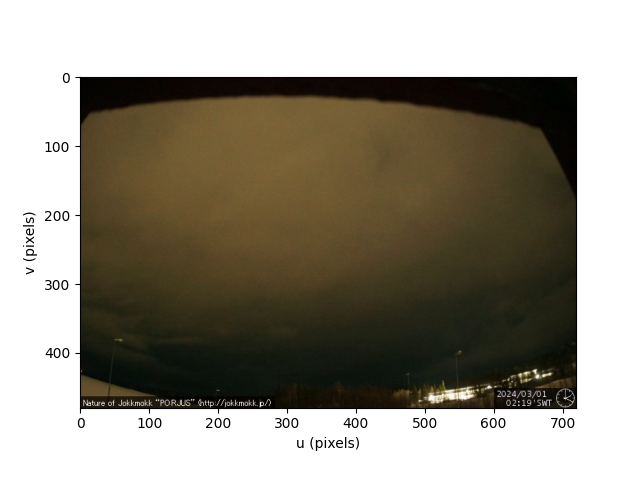

In [ ]:
# dartmouth = WebCam("https://webcam.dartmouth.edu/webcam/image.jpg");
# dartmouth.grab().disp();

# the camera above has worked since the first edition of the book, but is now not
# responding, here's a camera from Porjus, in Lappland, Sweden.
porjus= WebCam("http://uk.jokkmokk.jp/photo/nr4/latest.jpg");
porjus.grab().disp();


## 11.1.6 Images from Space


In [ ]:
if COLAB:
    # you must provide a Google API key, a 39 character string
    world = EarthView(key="API key");
else:
    # you're Google API key must be provided as the envariable GOOGLE_KEY
    world = EarthView()

In [ ]:
world.grab(-27.475722, 153.0285, 17).disp();

InvalidURL: URL can't contain control characters. '/maps/api/staticmap?center=-27.475722,153.0285&zoom=17&size=500x500&scale=1&format=png&maptype=satellite&key=API key&sensor=false' (found at least ' ')

In [ ]:
world.grab(-27.475722,153.0285, 15, type="map").disp();

InvalidURL: URL can't contain control characters. '/maps/api/staticmap?center=-27.475722,153.0285&zoom=15&size=500x500&scale=1&format=png&maptype=roadmap&key=API key&sensor=false' (found at least ' ')

In [ ]:
world.grab(-27.475722,153.0285, 15, type="roads").disp();

## 11.1.7 Images from Code


In [ ]:
image = Image.Ramp(cycles=2, size=500, dir="x");
image = Image.Sin(cycles=5, size=500, dir="y");
image = Image.Squares(number=5, size=500);
image = Image.Circles(number=2, size=500);

In [ ]:
canvas = Image.Zeros(1000, 1000, dtype="uint8")

In [ ]:
canvas.draw_box(lt=(100, 100), wh=(150, 150), color=100, thickness=-1);
canvas.draw_box(lt=(300, 300), wh=(80, 80), color=150, thickness=-1);

In [ ]:
canvas.draw_circle((600, 600), 120, color=200, thickness=-1)

In [ ]:
canvas.draw_line((100, 100), (800, 800), color=250, thickness=8)

In [ ]:
canvas.disp();

#  11.2 Pixel Value Distribution

In [ ]:
plt.close('all')
church = Image.Read("church.png", mono=True)

In [ ]:
church.min()
church.max()
church.mean()
church.median()
church.std()

In [ ]:
church.stats()

In [ ]:
h = church.hist()
h.plot();

In [ ]:
h.plot("ncdf", color="blue")

In [ ]:
x = h.peaks();
x.shape

In [ ]:
x = h.peaks(scale=25)

# 11.3 Monadic Operations


In [ ]:
church_float = church.to("float")
church.max()
church_float.max()

In [ ]:
church_float.to("uint8")

In [ ]:
street_float = Image.Read("street.png", dtype="float")

In [ ]:
gray = flowers.mono()

In [ ]:
color = gray.colorize()

In [ ]:
color = gray.colorize((1, 0, 0))

In [ ]:
bright = (church >= 180)

In [ ]:
bright.disp();

In [ ]:
church.stretch().stats()

In [ ]:
im = church.normhist();

In [ ]:
im = church.gamma_decode(1 / 2.2);

In [ ]:
im = church.gamma_decode("sRGB");

In [ ]:
(church // 64).disp();

In [ ]:
church.apply(lambda x: x // 64, vectorize=True).disp()

In [ ]:
church.npixels

In [ ]:
church.apply(lambda x: x // 64).disp();

In [ ]:
lut = [x // 64 for x in range(256)];  # create posterization lookup table
church.LUT(lut).disp();

# 11.4 Dyadic Operations


In [ ]:
church / 2       # new Image with all pixel values halved
church + 20      # new Image with all pixel values increased by 20
church - church  # new Image with all pixel values equal to 0

In [ ]:
church.apply2(church, lambda x, y: x - y, vectorize=True).disp();

In [ ]:
church.apply2(church, lambda x, y: x - y).disp();

In [ ]:
a = np.uint8(100)
b = np.uint8(200)

In [ ]:
a + b
a - b

In [ ]:
-a

In [ ]:
a / b

## 11.4.1 Applications
### 11.4.1.1 Application: Chroma Keying


In [ ]:
foreground = Image.Read("greenscreen.png", dtype="float")

In [ ]:
cc = foreground.gamma_decode("sRGB").chromaticity()

In [ ]:
plt.figure()
cc.plane("g").hist().plot()

In [ ]:
mask = cc.plane("g") < 0.45;
mask.disp();

In [ ]:
(foreground * mask).disp();

In [ ]:
background = Image.Read("road.png", dtype="float").samesize(foreground)

In [ ]:
(background * ~mask).disp();

In [ ]:
composite = foreground * mask  + background * ~mask;
composite.disp();

In [ ]:
background.choose(foreground, mask).disp();

### 11.4.1.2 Application: Motion detection


In [ ]:
video = VideoFile("traffic_sequence.mp4", mono=True, dtype="float")

In [ ]:
if COLAB:
  print("this example cannot run with CoLab")
else:
  sigma = 0.02; #sigma задает порог изменений в изображении, которые будут интерпретироваться как фоновые.
                # Это значение регулирует чувствительность детектора движения.
  background = None #background инициализируется как None. Это переменная для хранения текущего фонового изображения.
  for im in video: #Цикл проходит по каждому кадру видео (im).
    if background is None:
      background = im  # first frame only #При первой итерации первый кадр устанавливается как начальный фон (background = im).
    else:
      d = im - background #Для последующих кадров вычисляется разность d между текущим кадром и фоном.
      background += d.clip(-sigma, sigma) #Фон обновляется путем прибавления к нему ограниченного
                                          #по амплитуде изменения d.clip(-sigma, sigma).
                                          # Это позволяет фону адаптироваться к постепенным изменениям освещения
                                          # или к перемещению неподвижных объектов.
    # background.disp(reuse=True, fps=video.fps, block=None)

    background.disp(title="motion detection", reuse=True, fps=video.fps, matplotlib=False)
      #Метод disp отображает текущее фоновое изображение, обновляя его для каждого кадра, создавая визуализацию
      #процесса обнаружения движения.
         #title устанавливает заголовок окна визуализации.
           #reuse=True указывает на повторное использование окна для отображения, чтобы не открывать новое окно для каждого кадра.
              #fps=video.fps регулирует скорость воспроизведения анимации, соответствующую частоте кадров исходного видео.
                 #matplotlib=False говорит о том, что для отображения используется не Matplotlib, а, вероятно, встроенный метод или другая библиот
 cv_destroy_window("motion detection", block=False)


IndentationError: unindent does not match any outer indentation level (<tokenize>, line 22)

<div style="background-color:red">
<span style="background-color:red; font-size:20pt">NOTE</span>

The commented out code produces an animation for a Python script, however, using Jupyter it produces a set of separate images.  Use OpenCV instead (`matplotlib=False`) to display the animation in a separate window.
</div>

# 11.5 Spatial Operations
## 11.5.1 Linear Spatial Filtering


O = I.convolve(K);

### 11.5.1.1 Image Smoothing


In [ ]:
plt.close('all')

In [ ]:
K = Image.Constant(21, 21, value=1/21**2); #Линейное пространственное фильтрование выполняется путем свертки изображения с ядром (K).
                                           # Этот процесс можно записать как O = I.convolve(K);, где O - выходное изображение,
                                           # I - входное изображение, а K - ядро свертки.
                                           #создается постоянное ядро размером 21x21 с одинаковыми значениями, обеспечивающими усреднение.
                                           #Свертка изображения mona с этим ядром приведет к его сглаживанию.
K.shape

(21, 21)

21, 21 определяет размер ядра: 21x21 пикселей. Это означает, что ядро будет квадратным с 21 пикселем по каждой стороне.
value=1/21**2 задает значение каждого элемента в ядре.
Понимание value=1/21**2
21**2 возводит число 21 в квадрат, что равно 441. Это общее количество пикселей в ядре.
1/441 делит 1 на общее количество пикселей, давая приблизительно 0.0022675737. Это значение, которое будет присвоено каждому пикселю в ядре.

Зачем это нужно?
Это ядро используется для сглаживания или усреднения изображений путем свертки. При свертке изображения с таким ядром каждый пиксель в выходном изображении будет средним значением соответствующих пикселей входного изображения и его окрестности размером 21x21 пикселей. Поскольку сумма всех значений в ядре равна 1, это гарантирует, что общая яркость изображения не изменится после применения фильтра.

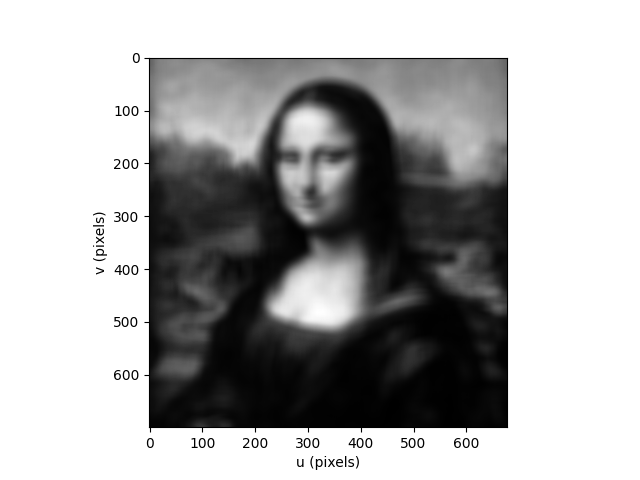

In [ ]:
mona = Image.Read("monalisa.png", mono=True, dtype="float")
mona.convolve(K).disp();

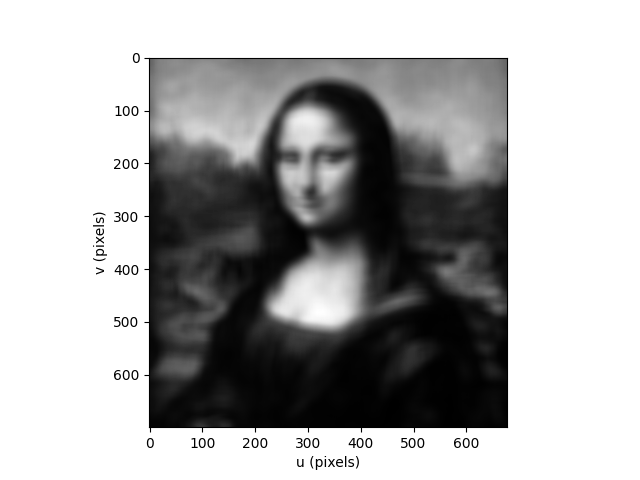

In [ ]:
K = Kernel.Box(h=10); #Kernel.Box(h=10) создает прямоугольное (или квадратное) ядро с равномерными значениями,
                      #размер которого определяется параметром h.
mona.convolve(K).disp();

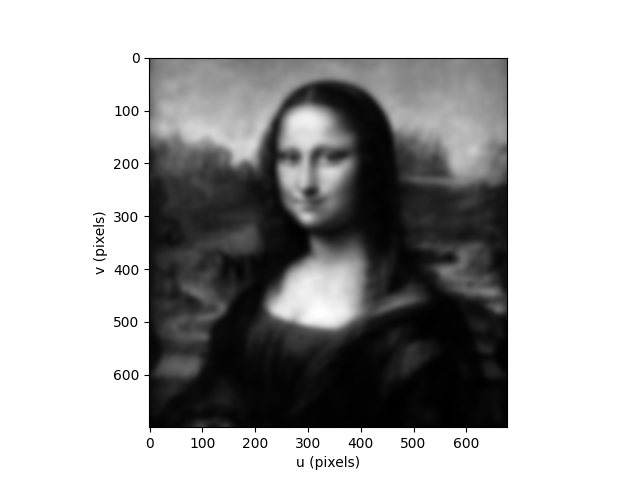

In [ ]:
K = Kernel.Gauss(sigma=5); #создает Гауссово ядро с указанным стандартным отклонением sigma,
                           #которое обеспечивает более "мягкое" сглаживание, поскольку веса в ядре уменьшаются по мере удаления от центра.
mona.convolve(K).disp();

In [ ]:
K.shape

(31, 31)

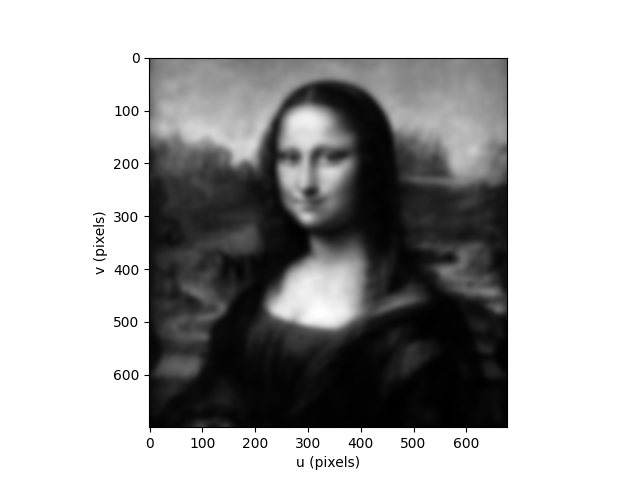

In [ ]:
mona.smooth(sigma=5).disp(); # для сглаживания изображения с Гауссовым ядром, созданным на основе параметра sigma.

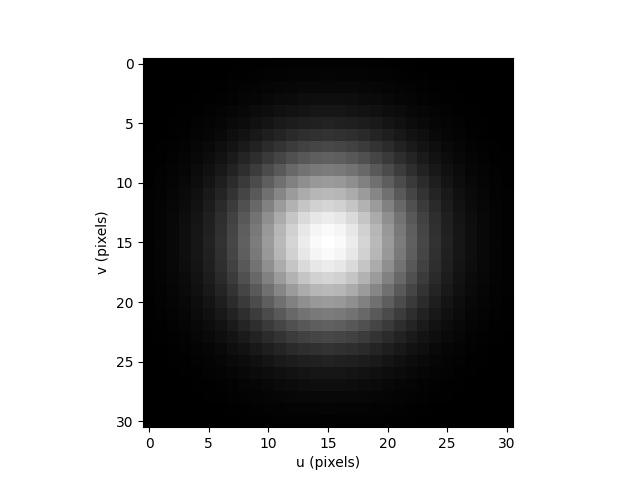

In [ ]:
idisp(K); #используется для отображения ядра, чтобы визуализировать его форму и значения.

In [ ]:
span = np.arange(-15, 15 + 1); #создает массив NumPy, содержащий последовательные целые числа от -15 до 15 включительно.
                                # Этот массив используется для определения координат по осям X и Y для сетки точек,
                                 # на которой будет построено трехмерное представление ядра.
X, Y = np.meshgrid(span, span)  #ринимает два одномерных массива и создает два двумерных массива,
                                 #где каждый элемент в массиве X представляет координату по оси X для соответствующей
                                  #точки в сетке, а каждый элемент в массиве Y представляет координату по оси Y для этой точки.
                                   #В результате получается сетка координат, охватывающая пространство, определенное span,
                                    # где X и Y представляют собой матрицы одинакового размера, содержащие координаты точек
                                     #по осям X и Y соответственно.
plt.subplot(projection="3d").plot_surface(X, Y, K); #Построение трехмерной поверхности
#plt.subplot(projection="3d") создает объект подграфика с трехмерной проекцией, на котором можно строить трехмерные графики.
                             #.plot_surface(X, Y, K) строит трехмерную поверхность, используя сетку координат,
#заданную массивами X и Y, и высоты, заданные значением K. В этом контексте K должен быть двумерным массивом,
#соответствующим значениям высоты точек поверхности над плоскостью XY.
#!!!Для успешного выполнения этого кода K должен быть двумерным массивом того же размера, что и массивы X и Y. Если K является объектом,

<ipython-input-38-47abcd6eea06>:3: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(projection="3d").plot_surface(X, Y, K);


In [ ]:
K = Kernel.Circle(radius=8, h=15);
#Kernel.Circle: Это вызов функции или конструктора класса, который создает круглое ядро.
#Ядро представляет собой матрицу, которая используется в операциях свертки
   #radius=8: Этот параметр определяет радиус круглого ядра. Радиус измеряется в пикселях и задает размер ядра.
   #В данном случае радиус равен 8 пикселям, что означает, что диаметр ядра будет 2*radius+1, т.е. 17 пикселей.
   #Это связано с тем, что ядро должно иметь центральный пиксель, вокруг которого располагаются остальные.
     #h=15 Размер массива 15х15 матрицы фильтра внктри него круг с 1 остальные 0
K

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]], dtype=uint8)

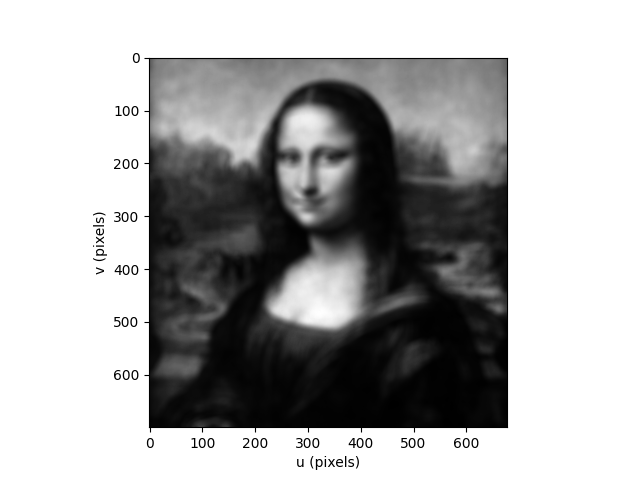

In [ ]:
mona.convolve(K).disp();

In [ ]:
K=Kernel.Box(h=15)

array([[0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041],
       [0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041],
       [0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.0010

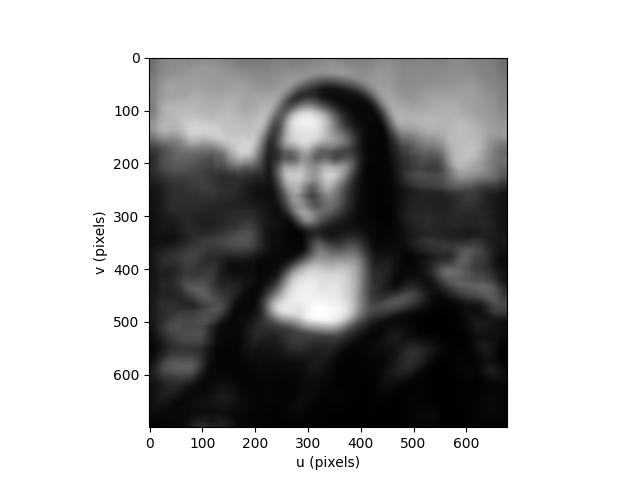

In [ ]:
mona.convolve(K).disp();

In [ ]:
K=Kernel.Box(h=15)
#Этот вызов создает квадратное ядро (или фильтр) с равномерными значениями (обычно единицами),
#где h=15 определяет высоту (и ширину, учитывая, что ядро квадратное) ядра в пикселях.
#Таким образом, получается матрица размером 15x15, где каждый элемент равен 1.
np.linalg.matrix_rank(K)
#: Этот вызов функции из библиотеки NumPy вычисляет ранг матрицы K.
#Ранг матрицы — это мера линейной независимости ее строк (или столбцов),
#то есть максимальное количество линейно независимых строк (или столбцов) в матрице.

1

In [ ]:
#Ваш код использует сингулярное разложение (SVD) для преобразования двумерного ядра K в два одномерных ядра:
#горизонтальное (Kh) и вертикальное (Kv).

U, s, Vh  = np.linalg.svd(K, full_matrices=True) #выполняет сингулярное разложение матрицы K.
                                                #SVD разлагает исходную матрицу на три компонента:
                                                #матрицу левых сингулярных векторов U,
                                                #диагональную матрицу сингулярных значений s
                                                #и матрицу правых сингулярных векторов Vh (транспонированная матрица правых сингулярных векторов V).
                                                #Параметр full_matrices=True указывает на то, что матрицы U и Vh должны быть полными,
                                                #то есть иметь размеры, соответствующие исходной матрице.
#Создание одномерных ядер
Kh = s[0] * U[:, 0]  # 1D horizontal kernel
  #Kh = s[0] * U[:, 0] создает одномерное горизонтальное ядро, умножая первый левый сингулярный вектор
  #на первое сингулярное значение. Это дает вектор, который может быть использован для фильтрации изображения
  #в горизонтальном направлении.

Kv = Vh[0, :]        # 1D vertical kernel
   #Kv = Vh[0, :] создает одномерное вертикальное ядро, используя первый правый сингулярный вектор.
   #Этот вектор может быть использован для фильтрации изображения в вертикальном направлении.
print(U)
#print(s)
#print(Vh)
#print(Kh)
#print(Kv)

[[ -0.1796 -0.07278        0        0        0        0        0        0        0        0        0        0        0
         0        0        0        0        0        0        0        0        0        0        0        0        0
         0        0        0        0    0.981]
 [ -0.1796  -0.1796  0.06812   0.6023   -0.346   0.4524   0.1479   0.1167     0.11   0.1849  -0.1693   0.2587 -0.06687
    0.1665  0.02575 -0.05156  0.03119  0.03964  0.09867 -0.001677  0.07521 -0.03357 -0.05406 -0.008117  0.05481
  -0.01268 0.007667  0.05344 -0.006832 -0.02067 -0.04621]
 [ -0.1796  -0.1796 -0.004866 -0.04302   0.6218   0.1861  -0.2533   0.3756  0.09885  -0.1456   0.1437   0.3363
    0.1339  0.05389 -0.01873  0.02728  0.02999  0.05815   0.1199    0.027   0.1078   0.1319 -0.07887  0.07424   0.1312
   0.03348  0.02362    0.197 0.007193  0.02119 -0.04621]
 [ -0.1796  -0.1796 -0.004866 -0.04302 -0.0004303   0.5588  -0.1957  -0.3923 -0.05448   -0.283   0.2051  -0.2907
  -0.09516  -0.2113  -0.1

In [ ]:
np.outer(Kh, Kv) #Выражение np.outer(Kh, Kv) использует функцию outer из библиотеки NumPy
                 # для создания внешнего произведения двух векторов: Kh и Kv
 #Kh = [a, b] и Kv = [x, y], внешнее произведение np.outer(Kh, Kv) будет:
 #[[a*x, a*y],
 # [b*x, b*y]]

array([[0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041],
       [0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041],
       [0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.0010

In [ ]:
С=np.outer(Kh, Kv)

array([[0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041],
       [0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041],
       [0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041,
        0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.001041, 0.0010

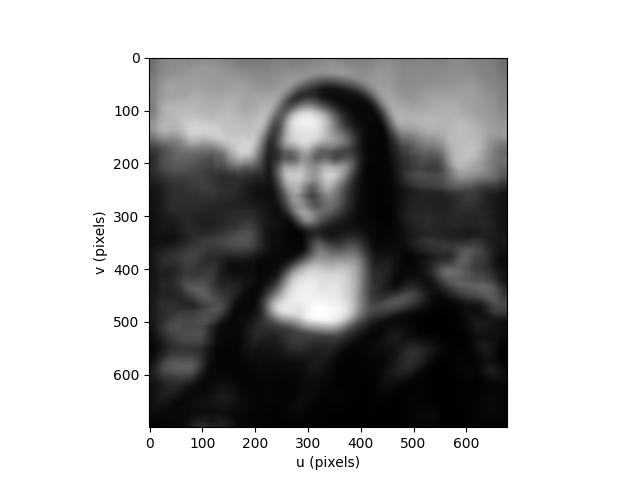

In [ ]:
mona.convolve(С).disp();

### 11.5.1.2 Border Extrapolation
### 11.5.1.3 Edge Detection


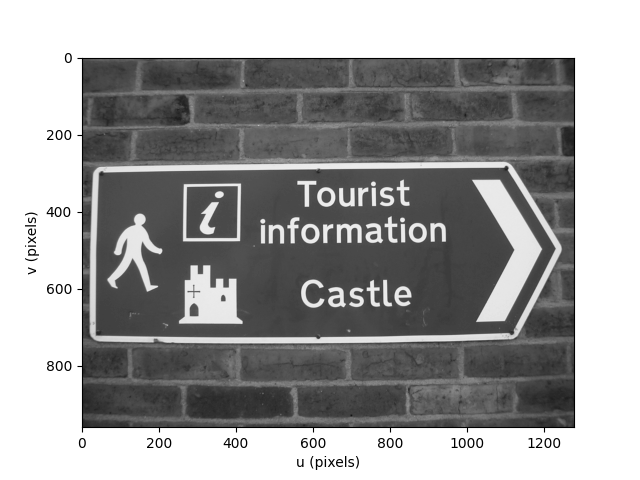

In [ ]:
castle = Image.Read("castle.png", mono=True, dtype="float")
castle.disp()

In [ ]:
profile = castle.image[360, :];# Извлекает строку пикселей из изображения на уровне 360 пикселей от верха.
#Это действие создает одномерный массив, представляющий профиль интенсивности пикселей вдоль этой строки
profile.shape #Возвращает размерность извлеченного профиля, что должно подтвердить его одномерный характер.

(1280,)

In [ ]:
#%matplotlib inline
#%matplotlib notebook
#import matplotlib
#matplotlib.use('TkAgg')  # Использование Tk GUI бэкенда
# Импортируйте pyplot только после установки бэкенда
#import matplotlib.pyplot as plt
#!pip install --upgrade --force-reinstall matplotlib

In [ ]:
plt.plot(profile) #Строит график профиля интенсивности. На графике вертикальная ось представляет интенсивность пикселей,
                  # а горизонтальная ось — их позицию в строке.
#plt.show(block=True)

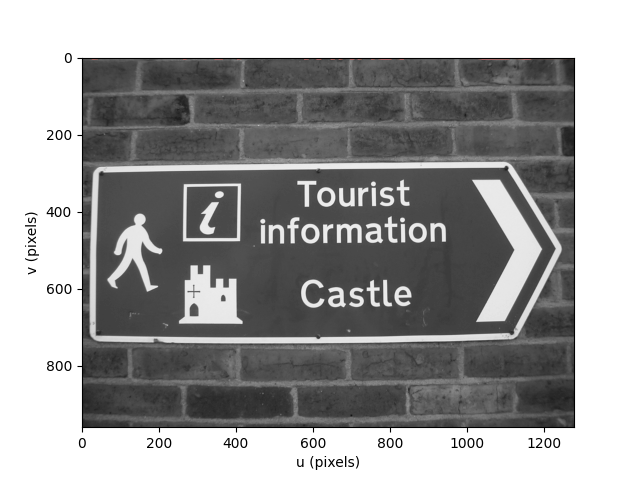

In [ ]:
plt.plot(np.diff(profile)) #np.diff(profile) вычисляет разность между каждым последующим элементом в массиве profile
                           #и его предшественником. Это эффективно выделяет изменения интенсивности между соседними пикселями.
                           #Результатом является новый массив, длина которого на один меньше исходного массива profile,
                           #поскольку для первого элемента нет предыдущего значения, с которым можно было бы сравнить.
  #plt.plot(np.diff(profile)) строит график разностей интенсивности. На этом графике пики указывают на места,
  #где интенсивность изображения резко меняется, что часто соответствует краям объектов.
plt.show(block=True)

Анализируя график разностей, можно определить, где на изображении происходят значительные изменения интенсивности, что является ключевым для обнаружения краев. Большие положительные значения указывают на резкое увеличение интенсивности, что может соответствовать переходу от темного к светлому. Аналогично, большие отрицательные значения указывают на резкое уменьшение интенсивности, что может соответствовать переходу от светлого к темному.

Этот метод является основой многих алгоритмов обнаружения краев, где главная цель — найти места на изображении, где интенсивность резко меняется, поскольку это часто соответствует границам объектов.

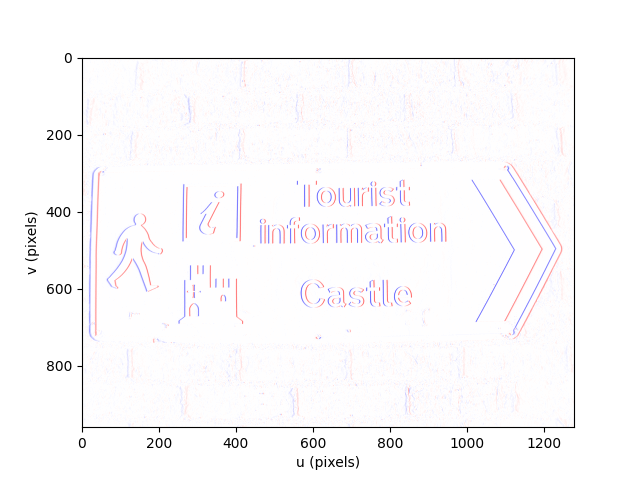

In [ ]:
K = [0.5, 0, -0.5]; #Это простое горизонтальное ядро, предназначенное для выделения горизонтальных изменений в изображении.
                    #Оно работает, вычитая средний интенсивностный уровень справа от пикселя из среднего интенсивностного
                    #уровня слева от него. Это эффективно для обнаружения вертикальных краев.
castle.convolve(K).disp(colormap="signed"); #: Визуализирует результат свертки с ядром K. Использование колормапы "signed"
                    #предполагает отображение отрицательных значений одним цветом, положительных — другим,
                    #что удобно для визуализации направления краев.

In [ ]:
Du = Kernel.Sobel() #Создает ядро Собеля, которое обычно используется для выделения краев в изображении,
                    #особенно эффективно обнаруживая вертикальные края благодаря своей горизонтальной ориентации.

array([[   0.125,        0,   -0.125],
       [    0.25,        0,    -0.25],
       [   0.125,        0,   -0.125]])

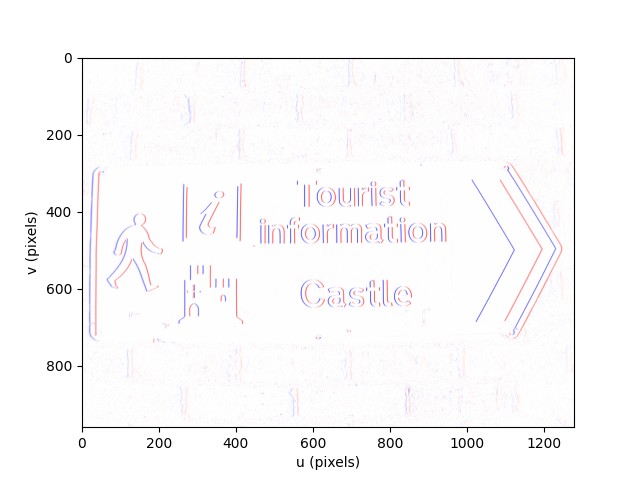

In [ ]:
castle.convolve(Du).disp(colormap="signed"); # Визуализирует результат применения ядра Собеля к изображению castle,
                                             #что помогает выявить вертикальные края.

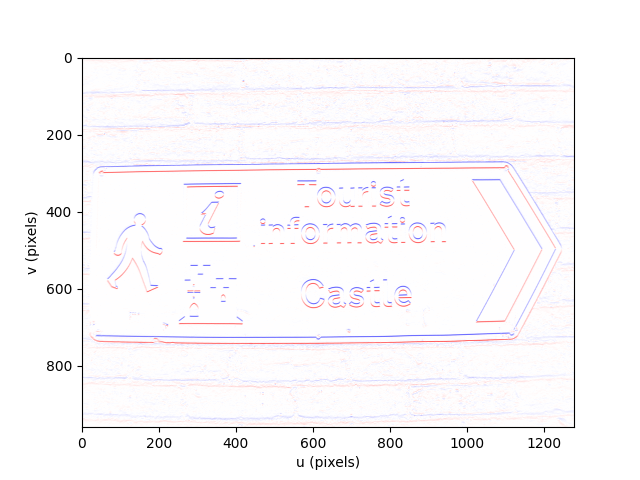

In [ ]:
castle.convolve(Du.T).disp(colormap="signed");
#Du.T: Транспонирование ядра Собеля переворачивает его, делая ориентацию вертикальной.
#Это позволяет ядру эффективно обнаруживать горизонтальные края в изображении.
   #.disp(colormap="signed"): Подобно предыдущим вызовам, визуализирует результат свертки,
   #но на этот раз для выявления горизонтальных краев.

In [ ]:
#Комбинирование Собеля и Гауссовой свертки
from scipy.signal import convolve2d
Gu = convolve2d(Du, Kernel.Gauss(sigma=1)); #происходит комбинация ядра Собеля Du с Гауссовым размытием Kernel.Gauss(sigma=1)
                                            #через двумерную свертку.
                                            #Это позволяет сгладить изображение перед выделением краев, уменьшая влияние шума.
Gu.shape #возвращает размеры полученного скомбинированного ядра,
         #что полезно для понимания его размера и потенциального влияния на изображение

(9, 9)

In [ ]:
Xu = castle.convolve(Kernel.DGauss(sigma=2));
   #Kernel.DGauss(sigma=2) создает ядро Гаусса для вычисления производных, что позволяет выявить края,
   #основываясь на изменениях интенсивности, сглаженных Гауссовым фильтром.
   #
Xv = castle.convolve(Kernel.DGauss(sigma=2).T);
#Применение этого ядра и его транспонированной версии к изображению castle позволяет
#получить горизонтальные (Xu) и вертикальные (Xv) компоненты градиента

In [ ]:
#castle.disp()

In [ ]:
# Вычисление магнитуды градиента
m = (Xu ** 2 + Xv ** 2).sqrt()
#вычисление магнитуды градиента изображения, что является общей мерой силы краев в каждой точке.
#Квадраты горизонтальных и вертикальных компонентов градиента суммируются,
#после чего из суммы извлекается квадратный корень. Это дает окончательное представление о
#силе и направлении краев на изображении.

Image: 1280 x 960 (float32)

In [ ]:
th = Xv.apply2(Xu, np.arctan2);  # arctan2(Xv, Xu)
#Здесь используется метод apply2 для вычисления арктангенса отношения двух массивов (Xv и Xu),
#которые представляют вертикальные и горизонтальные компоненты градиента изображения соответственно.
#Функция np.arctan2 позволяет определить угол градиента в каждой точке изображения.

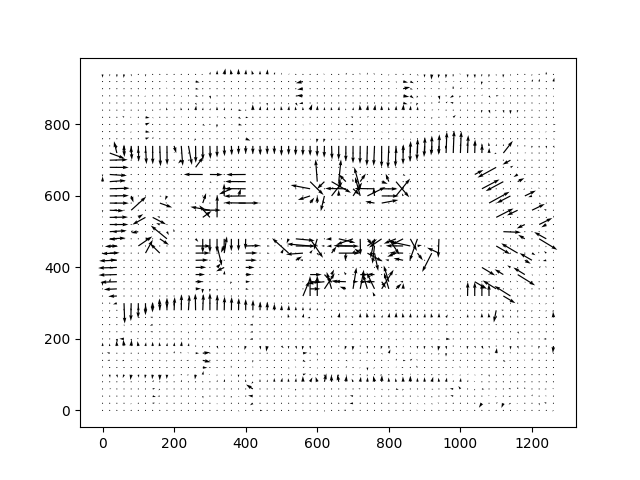

In [ ]:
plt.figure() #Дважды повторяется код для создания векторного поля
#которое визуализирует направления и величины градиентов на изображении.
plt.quiver(castle.uspan(20), castle.vspan(20), #Методы uspan и vspan используются для создания сетки координат
  Xu.image[::20, ::20], Xv.image[::20, ::20], scale=10); #а ::20 указывает на шаг выборки,
                                           #сокращая количество стрелок в векторном поле для упрощения визуализации
                                           #scale контролирует масштабирование стрелок.

In [ ]:
Xu, Xv = castle.gradients(Kernel.DGauss(sigma=2)) #вычисляет градиенты изображения, используя ядро градиента Гаусса с sigma=2,
# что помогает выявить края, сглаживая изображение и вычисляя его производные одновременно.

In [ ]:
print(Xu)
print(Xv)

Image: 1280 x 960 (float32)
Image: 1280 x 960 (float32)


In [ ]:
edges = castle.canny()
 # применяет детектор краев Канни к изображению castle, один из самых эффективных алгоритмов
 # обнаружения краев, который использует многократные этапы для выявления значимых краев.

Image: 1280 x 960 (uint8)

Применение Лапласиана Гаусса и анализ профиля интенсивности

In [ ]:
L = Kernel.Laplace()
 #создает ядро Лапласиана. В данном случае, переменная L инициализируется,
 # но далее по тексту не используется. Лапласиан используется для выявления областей быстрого изменения
 #интенсивности в изображении, что часто соответствует краям.

array([[ 0,  1,  0],
       [ 1, -4,  1],
       [ 0,  1,  0]])

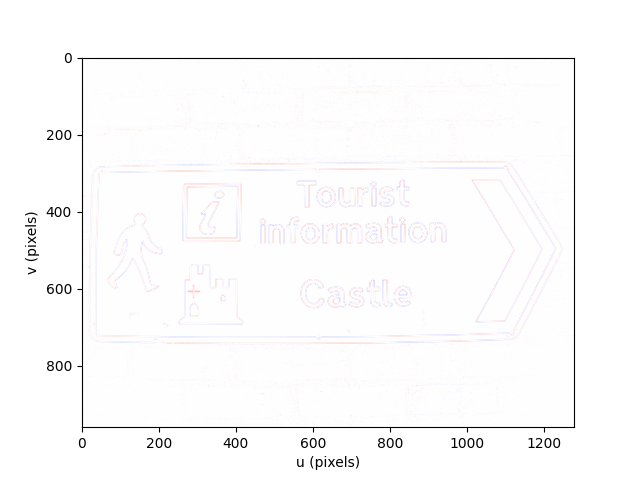

In [ ]:
castle.convolve(L).disp(colormap="signed");

In [ ]:
lap = castle.convolve(Kernel.LoG(sigma=2));
  #Kernel.LoG(sigma=2) создает ядро Лапласиана Гаусса с параметром размытия sigma=2.
  #LoG является комбинацией Гауссова сглаживания (для подавления шума и уменьшения детализации)
  # и второй пространственной производной (Лапласиан), которая помогает выявить края.
  #Параметр sigma контролирует степень размытия: большее значение sigma приводит к более сильному сглаживанию.
    #lap = castle.convolve(Kernel.LoG(sigma=2)) применяет созданное ядро LoG к изображению castle путем свертки,
    #результатом чего является новое изображение lap, где края выделены более четко.

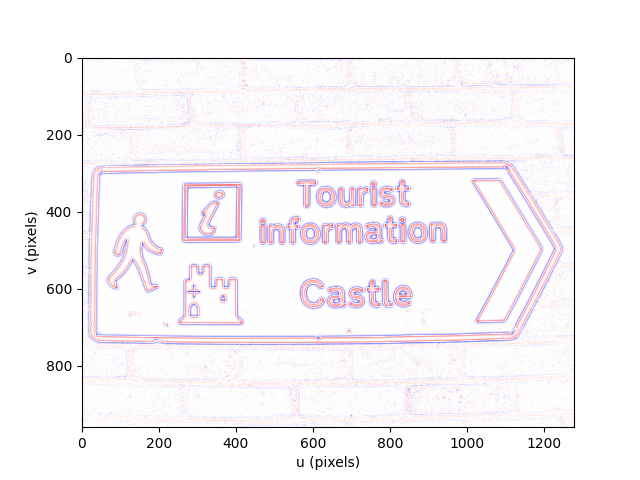

In [ ]:
lap.disp(colormap="signed")

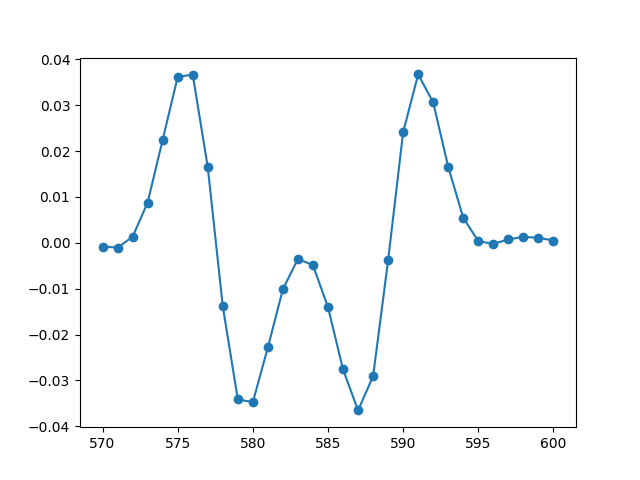

In [ ]:
#Анализ профиля интенсивности
profile = lap.image[360, 570:601]; #извлекает горизонтальный срез интенсивности из обработанного изображения lap
                                   # начиная с пикселя 570 по 600 включительно на строке 360. Этот срез позволяет
                                   #анализировать изменения интенсивности вдоль определенной линии изображения.

plt.figure() #создает новую фигуру, позволяя вам начать рисовать новый график с чистого листа.
             #Эта функция может принимать различные параметры, такие как размер фигуры (figsize),
             #разрешение (dpi) и другие, позволяя настроить внешний вид создаваемой фигуры.

plt.plot(np.arange(570, 601), profile, "-o"); #троит график извлеченного профиля интенсивности.
                                              #По оси X отложены позиции пикселей (от 570 до 600),
                                              #а по оси Y — значения интенсивности в этих пикселях.
                                              #Маркер "-o" указывает на то, что точки соединяются линиями,
                                              #и каждая точка отмечается кружком.

In [ ]:
zc = lap.zerocross(); #zerocross() метод, предположительно, используется для нахождения точек пересечения нуля
                       #в результате применения Лапласиана Гаусса. Точки, где производная изображения пересекает ноль,
                       #часто соответствуют краям. Это метод основан на идее, что края можно определить как места,
                       #где вторая производная изображения меняет знак.
#zc.disp()

## 11.5.2 Template Matching


In [ ]:
mona = Image.Read("monalisa.png", mono=True, dtype="float");
A = mona.roi([170, 220, 245, 295]); #mona.roi([170, 220, 245, 295]): Выделяет область интереса (ROI)
                                    #из изображения mona. Координаты [170, 220, 245, 295] определяют прямоугольную область
                                    # с верхним левым углом в (170, 220) и нижним правым углом в (245, 295).

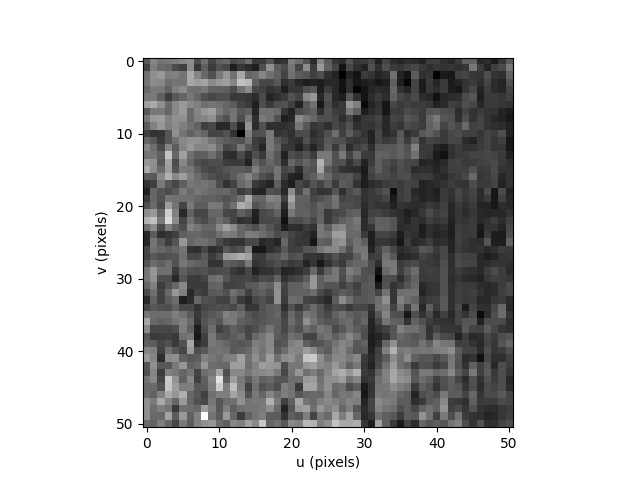

In [ ]:
A.disp()

Сравнение изображений с помощью различных метрик
SAD (Sum of Absolute Differences), SSD (Sum of Squared Differences) и NCC (Normalized Cross-Correlation)

In [ ]:
B = A
A.sad(B) #Вычисляет сумму абсолютных разностей между соответствующими пикселями двух изображений.
         #Эта метрика минимальна, когда изображения идентичны.
A.ssd(B)  #Вычисляет сумму квадратов разностей между пикселями изображений.
          #Как и SAD, минимизируется для идентичных изображений.
A.ncc(B)   #Вычисляет нормализованную кросс-корреляцию между изображениями,
           #мера схожести, которая достигает максимума для идентичных изображений.

1.0

In [ ]:
B = 0.9 * A  #Изображение B модифицируется путем умножения на коэффициент и добавления константы,
             #соответственно, для имитации изменений в освещенности или контрасте.
A.sad(B)
A.ssd(B)

0.347583

ZSAD (Zero-mean Sum of Absolute Differences), ZSSD (Zero-mean Sum of Squared Differences) и ZNCC (Zero-mean Normalized Cross-Correlation):

Эти метрики аналогичны SAD, SSD и NCC, но применяются к изображениям с вычитанием их среднего значения, что делает их менее чувствительными к изменениям в освещенности.

Описание: SAD вычисляет сумму абсолютных разностей между соответствующими пикселями двух изображений или областей изображений. Это мера, которая показывает, насколько в сумме отличаются значения пикселей двух изображений.

Описание: SSD вычисляет сумму квадратов разностей между соответствующими пикселями двух изображений. SSD более чувствителен к большим отклонениям между пикселями по сравнению с SAD, поскольку разности возводятся в квадрат.

Описание: NCC измеряет нормализованную кросс-корреляцию между двумя изображениями, что является мерой их линейной зависимости. Значение NCC лежит в диапазоне от -1 до 1, где 1 означает идеальное совпадение, 0 — отсутствие корреляции, и -1 — полное противоположение.
Применение: NCC полезен для сопоставления шаблонов в ус

In [ ]:
A.ncc(B)

1.0000001

In [ ]:
B = A + 0.1

A.sad(B) # SAD (Sum of Absolute Differences)
# Чем меньше значение SAD, тем более похожи изображения. Это полезно для поиска похожих областей
#или для трекинга объектов на последовательных кадрах видео.

A.ssd(B) # SSD (Sum of Squared Differences)
#Минимальное значение SSD указывает на наибольшее сходство. SSD особенно полезен,
#когда необходимо сильно "наказать" большие различия между пикселями.

A.ncc(B) # NCC (Normalized Cross-Correlation)

0.9863699

Нормализованные (с нулевым средним) версии
ZSAD (Zero-mean Sum of Absolute Differences), ZSSD (Zero-mean Sum of Squared Differences), и ZNCC (Zero-mean Normalized Cross-Correlation) модифицируют вышеупомянутые метрики, вычитая среднее значение из пикселей каждого изображения перед вычислением. Это делает метрики менее чувствительными к абсолютным различиям в освещенности или контрасте между изображениями.

A.zsad(B), A.zssd(B), A.zncc(B): Эти методы применяют нормализацию к изображениям перед вычислением SAD, SSD и NCC соответственно. Это улучшает их способность сравнивать изображения в условиях, когда изменения освещенности могут исказить результаты.

In [ ]:
A.zsad(B)
A.zssd(B)
A.zncc(B)

1.0

In [ ]:
B = 0.9 * A + 0.1
A.zncc(B)

1.0

### 11.5.2.1 Application: Finding Wally


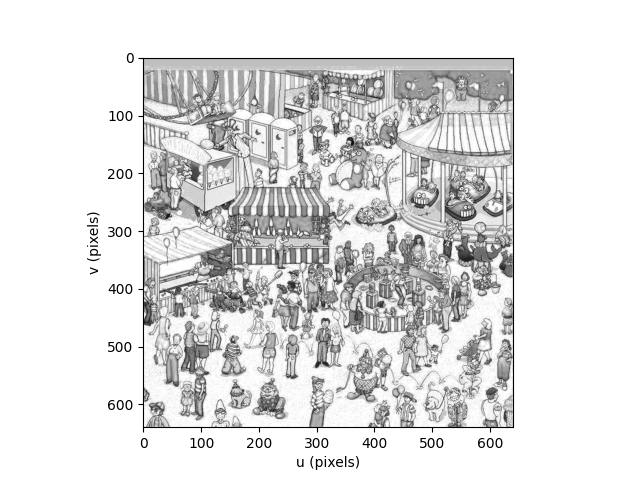

In [ ]:
crowd = Image.Read("wheres-wally.png", mono=False, dtype="float")
crowd.disp();

Image: 21 x 25 (float32) [.../images/wally.png]

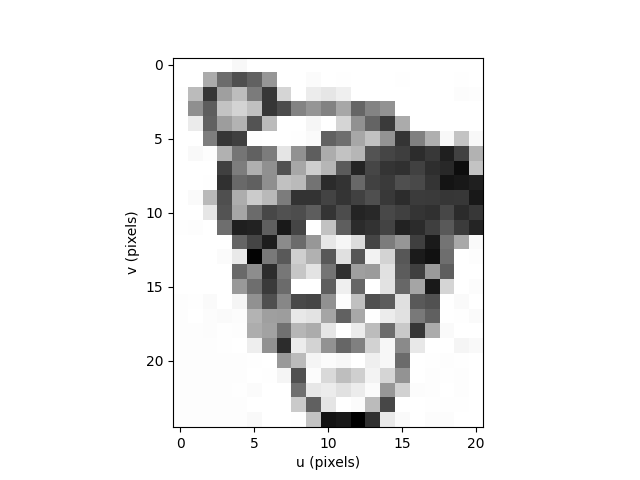

In [ ]:
T = Image.Read("wally.png", mono=False, dtype="float")
T.disp();
T

In [ ]:
sim = crowd.similarity(T, "zncc") #Вычисление схожести: Используется метод similarity с параметром "zncc"
                                  #(Zero-mean Normalized Cross-Correlation)
 #который вычисляет нормализованную кросс-корреляцию с нулевым средним между изображением толпы и шаблоном Волли.
 #Это дает карту схожести, где каждый пиксель отражает степень схожести его окрестности с шаблоном.

Image: 620 x 616 (float32)

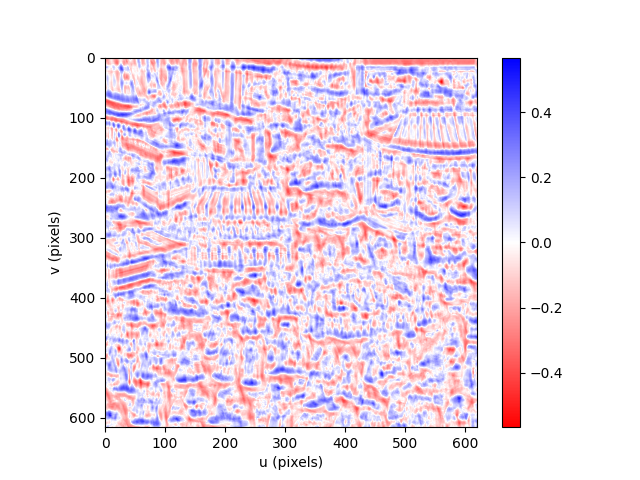

In [ ]:
sim.disp(colormap="signed", colorbar=True); #Карта схожести отображается с использованием специальной
                                            #карты цветов и цветовой шкалы (colorbar=True)

Определение локации и визуализация

In [ ]:
maxima, location = sim.peak2d(scale=2, npeaks=5) # используется для нахождения координат пиков на карте схожести,
                                                 #которые соответствуют наиболее вероятным местоположениям Волли.
                                                 # используется для нахождения координат пиков на карте схожести,
                                                 #которые соответствуют наиболее вероятным местоположениям Волли.
#Метод peak2d ищет локальные максимумы (пики) на карте схожести.
#npeaks=5 указывает на максимальное количество пиков, которые нужно найти.
#Результатом работы метода являются две переменные: maxima, содержащая значения максимумов,
#и location, содержащая их координаты.
maxima

array([  0.5258,    0.523,   0.5222,   0.5032,   0.5023])

In [ ]:
location

array([[     250,        8,      590,      397,      289],
       [     364,      596,      568,      417,      551]])

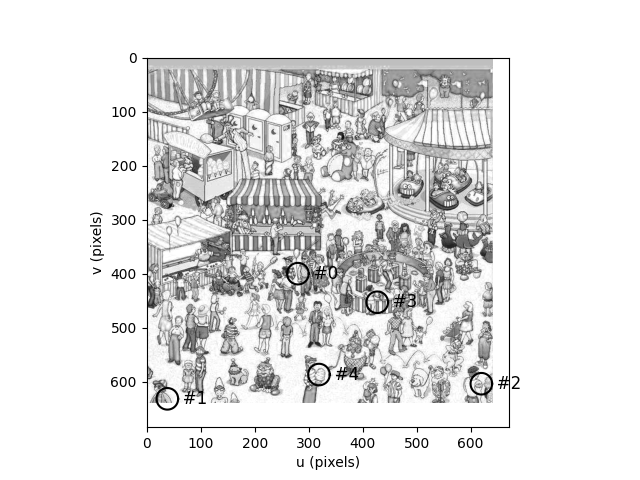

In [ ]:
crowd.disp(block=None); #crowd.disp(block=None): Отображает исходное изображение с толпой.
                        #Параметр block=None может контролировать поведение отображения, например,
                        #позволяя продолжить выполнение кода без ожидания закрытия окна с изображением.

location += np.c_[T.shape[::-1]].T // 2 #np.c_[T.shape[::-1]]: Создает массив из размеров шаблона T,
                                        #но в обратном порядке ([::-1]),
                                        #что соответствует преобразованию (height, width) в (width, height)

                                         #Оператор np.c_[] используется для создания одноколоночного массива из этих значений.

                                          #.T транспонирует полученный одноколоночный массив, превращая его в однострочный массив.

                                           #// 2 делит каждый элемент массива на 2, используя целочисленное деление.
                                           #-- Размер шаблона Волли (T) составляет 20x30 пикселе
                                           #-- Смещение составляет [(30/2, 20/2)] = [(15, 10)].
                                           #-- Это значение добавляется к каждой из найденных координат, корректируя их положение.
                                           #Это вычисляет смещение, необходимое для коррекции координат пиков,
                                           #поскольку карта схожести меньше исходного изображения на размер шаблона.
                                           #Деление на 2 обусловлено тем, что координаты максимумов на карте схожести
                                           #относятся к верхнему левому углу шаблона, а не к его центру.

                                            #location += обновляет координаты пиков, добавляя вычисленное смещение,
                                            #чтобы скорректировать положение пиков относительно исходного изображения.

                                         # offset to account for smaller size of sim image
                                         #Корректировка локации: Поскольку размер карты схожести меньше размера
                                         #исходного изображения из-за границ шаблона, координаты пиков корректируются на
                                         #половину размера шаблона для точного соответствия на исходном изображении.


plot_circle(centre=location, radius=20, color="k");  #plot_circle(...): Рисует круги на исходном изображении для
                                                     # визуализации найденных локаций Волли.
                                                     #Параметры указывают на координаты центров
                                                     #кругов (centre=location), радиус кругов (radius=20)
                                                      #и цвет (color="k", что обычно означает черный).

plot_point(location, color="none", marker="none", text="  #{}"); # На исходном изображении (crowd) визуализируются области,
                                                                   #соответствующие найденным локациям, с помощью функций plot_circle
                                                                   #plot_point(...): Этот вызов предназначен для отображения точек
                                                                   # на изображении, но в данном случае, судя по параметрам
                                                                    #(color="none", marker="none"), точки не будут визуально
                                                                    #отмечены. Вместо этого может использоваться параметр text
                                                                    #для добавления текстовой аннотации к каждой локации,
                                                                    #хотя конкретный формат строки " #{}" предполагает

<div style="background-color:red">
<span style="background-color:red; font-size:20pt">NOTE</span>

In the book this image couldn't be published because I couldn't get a copyright release, in fact I couldn't even find out who is actually the copyright holder.

The image fron the similarity matching is smaller than the input image.
</div>

In [ ]:
print(crowd.shape)
print(sim.shape)

(640, 640)
(616, 620)


Pixels where the template crosses the image boundary are not included.  See the [OpenCV documentation](https://docs.opencv.org/4.x/df/dfb/group__imgproc__object.html#ga586ebfb0a7fb604b35a23d85391329be) for details.  To account for this we need to offset the locations of the peaks by the half-width of the template image.

### 11.5.2.2 Nonparameteric Local Transforms
## 11.5.3 Nonlinear Operations


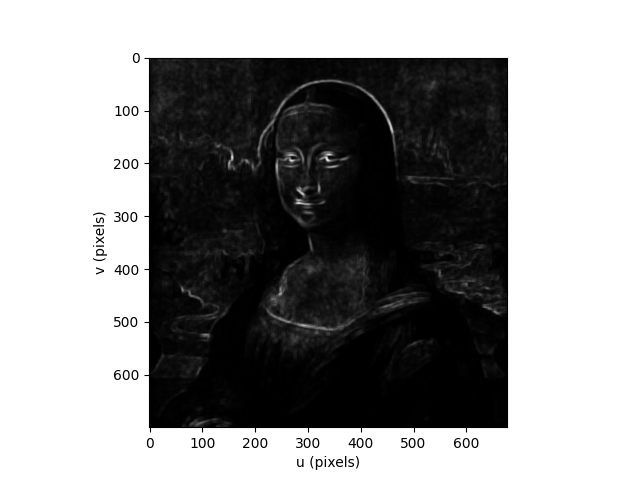

In [ ]:
out = mona.window(np.var, h=3);
#Применяет функцию np.var (дисперсия) к каждому пикселю изображения mona
#в рамках окна размером h=3. Это означает, что для каждого пикселя вычисляется
#дисперсия значений интенсивности в окне 3x3 вокруг данного пикселя.
#Результатом является новое изображение, где каждый пиксель отражает дисперсию
#локальной области исходного изображения. Такой подход может помочь выявить области
#с высокими локальными вариациями интенсивности, что часто указывает на края или текстуры.
out.disp()

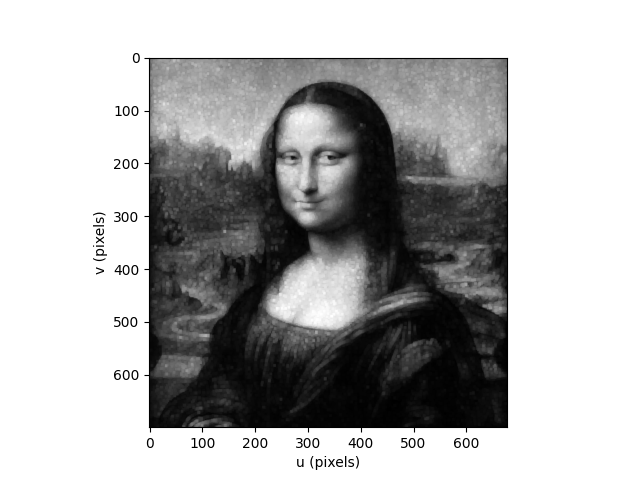

In [ ]:
mx = mona.rank(rank=0, h=2); #Вычисляет минимальное значение (ранг 0) в окне 2x2 вокруг каждого пикселя.
                             #Это приводит к "эрозии" изображения, делая светлые области меньше.
mx.disp()

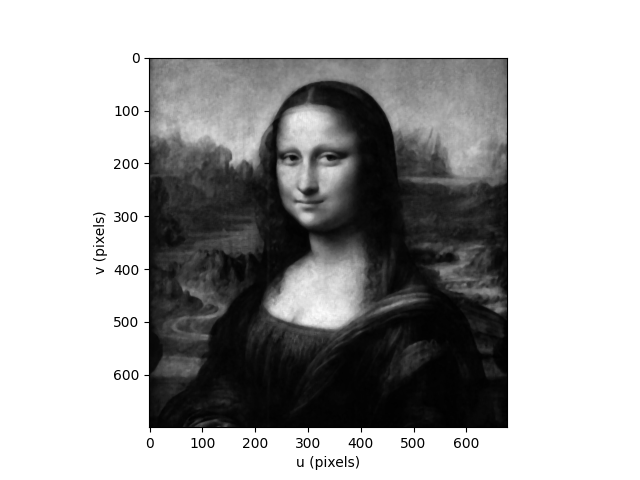

In [ ]:
med = mona.rank(rank=11, h=2); #Вычисляет медианный пиксель (при условии, что всего в окне 2x2 содержится 12 пикселей,
                               # индексация начинается с 0) в окне 2x2 вокруг каждого пикселя.
                               #Это действие уменьшает шум, сохраняя при этом края объектов.
med.disp()

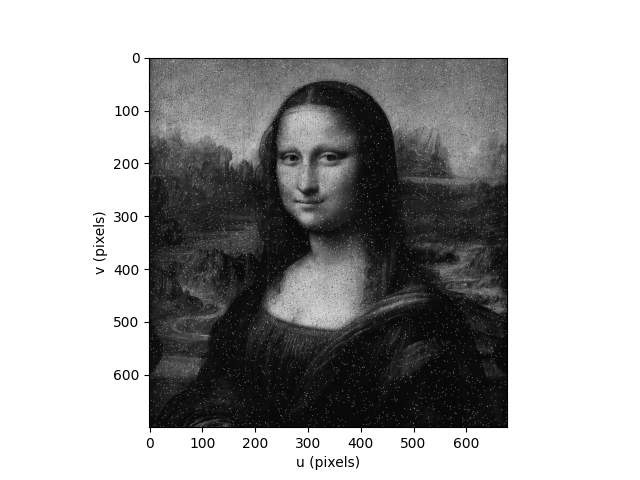

In [ ]:
spotty = mona.copy() #Создается копия изображения mona в переменную spotty.
pixels = spotty.view1d();  # Создается одномерное представление этого изображения (view1d),
                           # позволяя манипулировать пикселями как одномерным массивом.
npix = mona.npixels    # total number of pixels
k = np.random.choice(npix, 10_000, replace=True);  # choose 10,000 unique pixels
pixels[k[:5_000]] = 0  # set half of them to zero 0 (черный цвет),
pixels[k[5_000:]] = 1  # set half of them to one 1 (белый цвет),
spotty.disp();

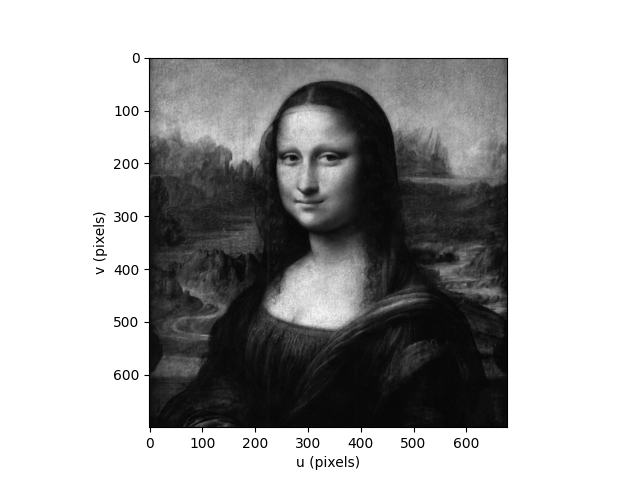

In [ ]:
spotty.rank(rank=4, h=1).disp(); #Применяет ранговую фильтрацию к "шумовому" изображению spotty,
                                 #выбирая пятый по величине пиксель в окне 1x1 вокруг каждого пикселя,
                                 #что, фактически, является попыткой уменьшить шум, добавленный на предыдущем шаге.

In [ ]:
#Создание и применение пользовательского футпринта
M = np.full((3, 3), True); #Создается матрица M, представляющая футпринт (структурирующий элемент),
                           #где все элементы, кроме центрального, установлены в True. Это означает,
                           #что при ранговой фильтрации будут учитываться только соседние пиксели, исключая сам пиксель.
M[1, 1] = False
M

array([[ True,  True,  True],
       [ True, False,  True],
       [ True,  True,  True]])

Image: 677 x 700 (float32)


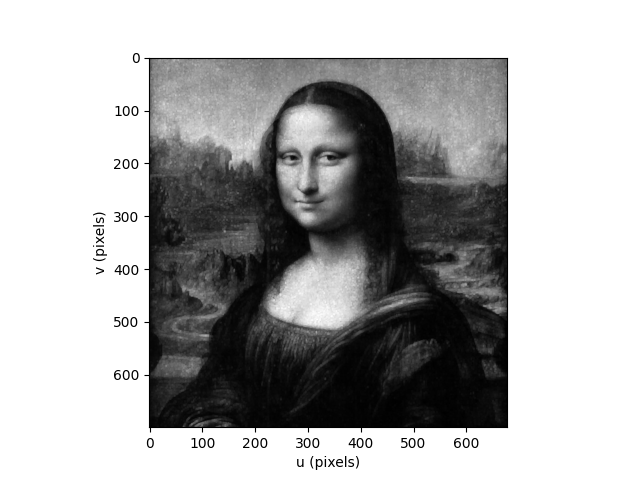

In [ ]:
max_neighbors = mona.rank(rank=0, footprint=M); #Применяется ранговая фильтрация с этим футпринтом
                                                #к изображению mona, выбирая минимальное значение среди соседей каждого пикселя.
print(max_neighbors);
max_neighbors.disp();

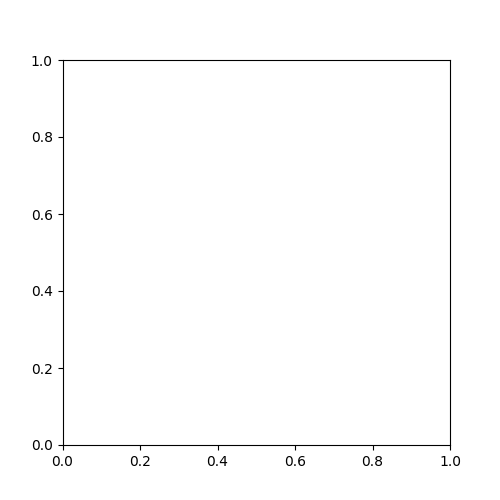

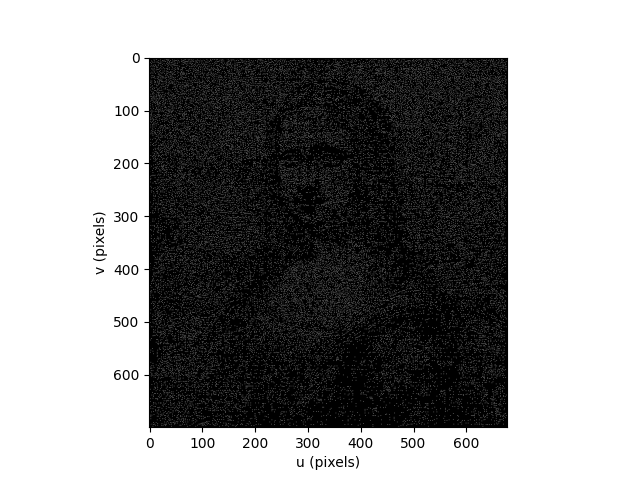

In [ ]:
#Создается большая фигура для визуализации результата, где отображаются пиксели исходного изображения mona,
#которые больше, чем соответствующие пиксели на обработанном изображении max_neighbors.
#Это может выделить области, где пиксели значительно выделяются на фоне своих соседей,
#что может быть использовано для выявления особенностей или аномалий на изображении.
fig, ax = plt.subplots(figsize=(5,5))  # display it large
(mona > max_neighbors).disp(ax=ax);

# 11.6 Mathematical Morphology


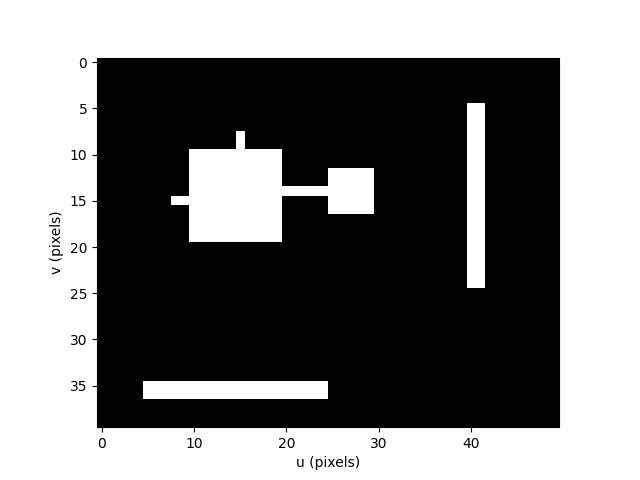

In [ ]:
im = Image.Read("eg-morph1.png")
im.disp();

In [ ]:
S = np.ones((5, 5)); #Создает структурирующий элемент (или ядро) размером 5x5,
                     #полностью заполненный единицами. Этот элемент будет использоваться для морфологических операций.
                     #Размер и форма структурирующего элемента влияют на результат обработки.
print(S)

[[       1        1        1        1        1]
 [       1        1        1        1        1]
 [       1        1        1        1        1]
 [       1        1        1        1        1]
 [       1        1        1        1        1]]


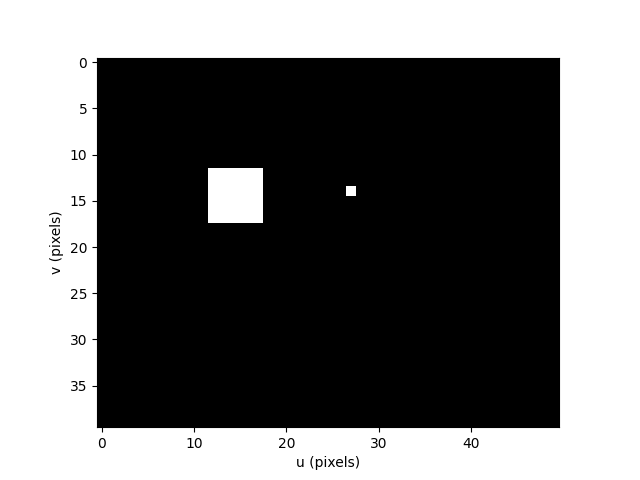

In [ ]:
e1 = im.morph(S, op="min") #im.morph(S, op="min"): Применяет операцию эрозии к изображению im с использованием
                           #структурирующего элемента S. В контексте данного кода, эрозия реализуется через операцию "min",
                           #выбирая минимальное значение в области под структурирующим элементом.
e1.disp()

morphdemo(im, S, op="min")

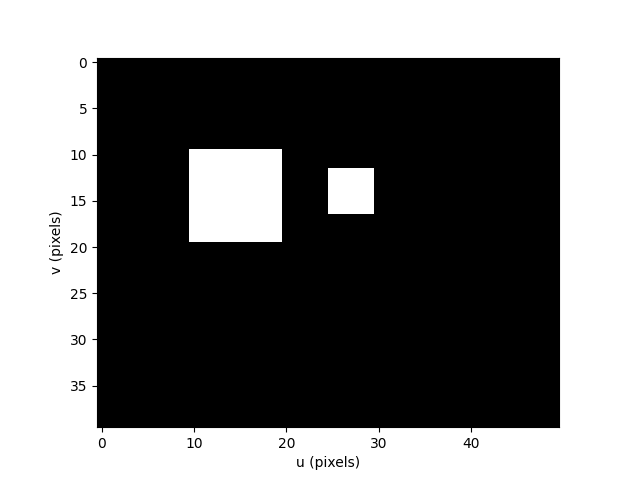

In [ ]:
d1 = e1.morph(S, op="max") #После применения эрозии к изображению выполняется операция дилатации (расширения)
                           # с тем же структурирующим элементом. Дилатация реализуется через операцию "max",
                           #выбирая максимальное значение в области под структурирующим элементом.
d1.disp()

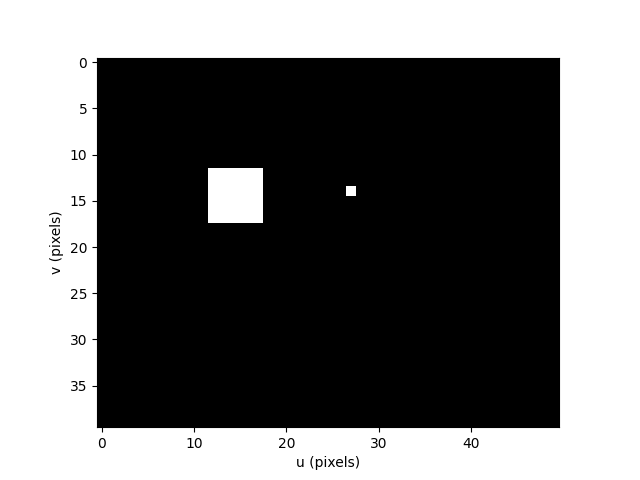

In [ ]:
out = im.erode(S); #Прямое применение операции эрозии к изображению im с использованием структурирующего элемента S.
                   #Эта операция уменьшает размер ярких областей и используется для удаления мелких деталей или шума.
out.disp()

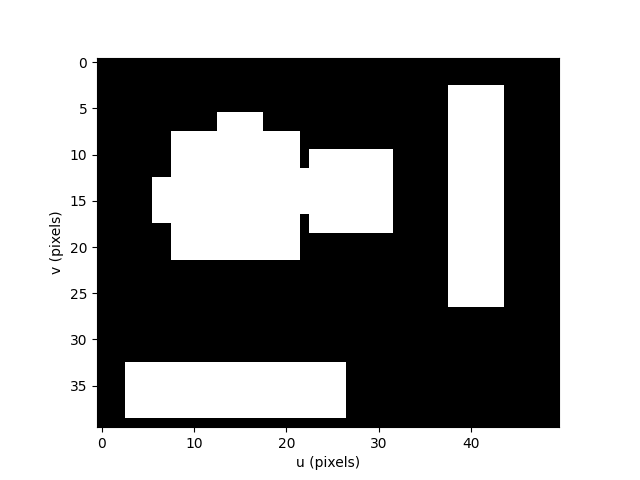

In [ ]:

out = im.dilate(S); # Прямое применение операции дилатации к изображению im.
                    #Эта операция увеличивает размер ярких областей и обычно используется после эрозии
                    #для восстановления размера объектов на изображении.
out.disp()

## 11.6.1 Noise Removal


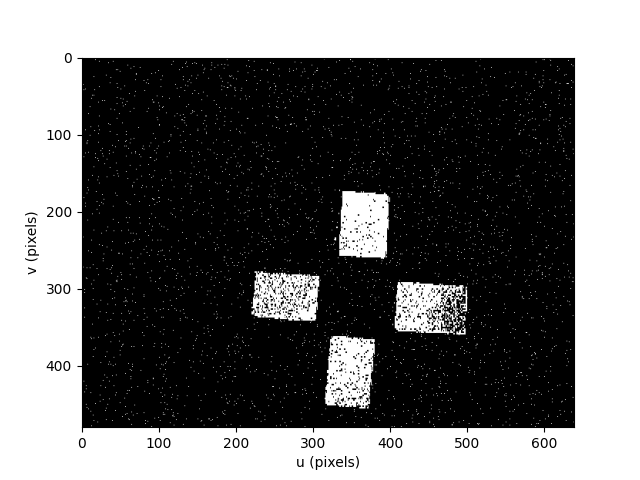

In [ ]:
objects = Image.Read("segmentation.png")
objects.disp();

In [ ]:
S_circle = Kernel.Circle(3) #Создает круглый структурирующий элемент (ядро) с радиусом 3 пиксел

array([[0, 0, 0, 1, 0, 0, 0],
       [0, 1, 1, 1, 1, 1, 0],
       [0, 1, 1, 1, 1, 1, 0],
       [1, 1, 1, 1, 1, 1, 1],
       [0, 1, 1, 1, 1, 1, 0],
       [0, 1, 1, 1, 1, 1, 0],
       [0, 0, 0, 1, 0, 0, 0]], dtype=uint8)

/usr/local/lib/python3.10/dist-packages/machinevisiontoolbox/base/imageio.py:271: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()  # fig creates a new window


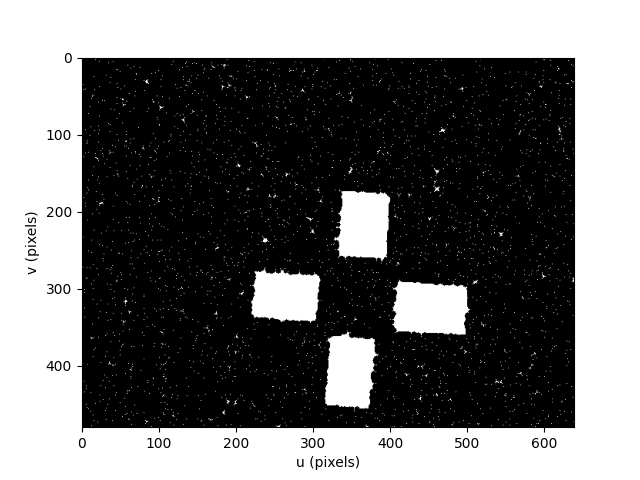

In [ ]:
closed = objects.close(S_circle); #objects.close(S_circle): Выполняет морфологическую операцию закрытия на изображении objects
                                  # с использованием структурирующего элемента S_circle.
closed.disp()

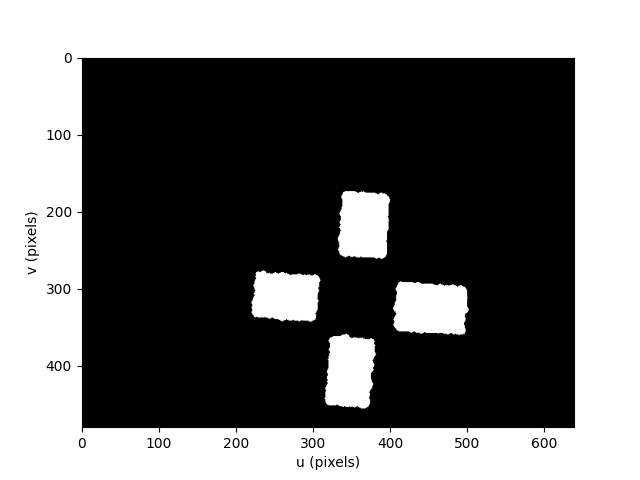

In [ ]:
#Применение операции открытия для дополнительной очистки
clean = closed.open(S_circle); #closed.open(S_circle): Применяет морфологическую операцию открытия к результату операции закрытия.
                               # Операция открытия состоит из последовательного применения эрозии, за которой следует дилатация.
                               # Это помогает убрать оставшийся шум и улучшить очертания объектов.
clean.disp()

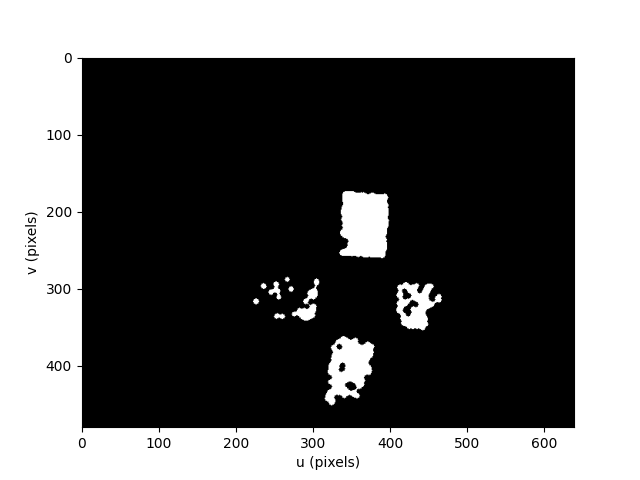

In [ ]:
objects.open(S_circle).close(S_circle).disp(); #Эта строка демонстрирует прямое сочетание операций открытия и закрытия
                                              #на исходном изображении objects, используя тот же структурирующий элемент S_circle.

## 11.6.2 Boundary Detection


 Этот метод особенно полезен для выделения контуров объектов на изображении, что может быть важно для задач сегментации, анализа формы и компьютерного зрения в целом

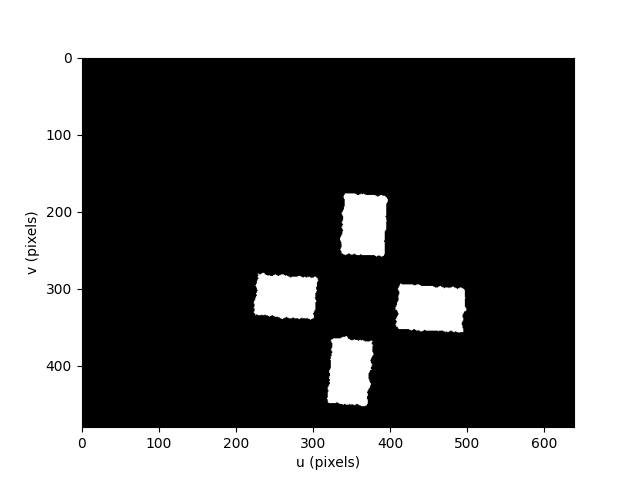

In [ ]:
eroded = clean.erode(S_circle) #clean.erode(S_circle): Применяет операцию эрозии к изображению clean,
# которое было получено на предыдущих шагах после применения операций закрытия и открытия для удаления шума.
# Эрозия использует структурирующий элемент S_circle, созданный ранее, который влияет на каждый пиксель изображения,
#заменяя его минимальным значением из его локального окружения, определяемого формой структурирующего элемента.
eroded.disp()

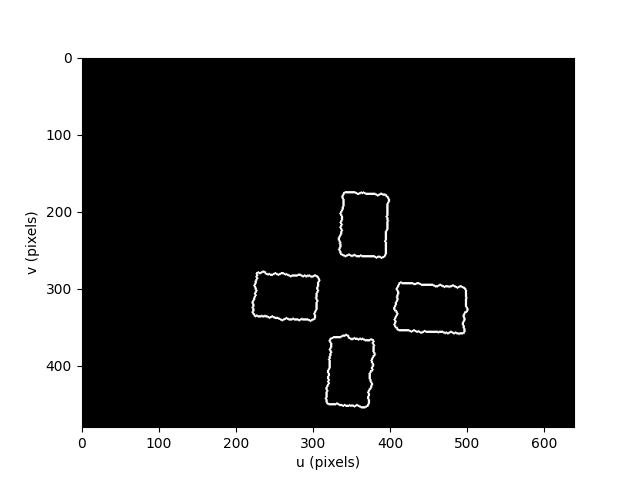

In [ ]:
#Вычисление границ путем вычитания эродированного изображения из исходного
edge = clean - eroded #Вычисляет разницу между исходным очищенным изображением clean
                      # и его эродированной версией eroded. Это действие выделяет пиксели,
                      #которые были убраны в процессе эрозии, эффективно выделяя границы объектов.
edge.disp();

## 11.6.3 Hit or Miss Transform


out = image.hitormiss(S);

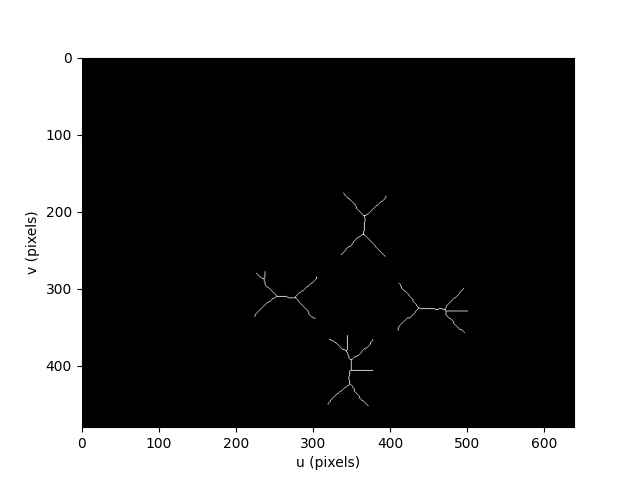

In [ ]:
skeleton = clean.thin(); #clean.thin(): Выполняет операцию тонирования (или скелетонизации)
                         #на очищенном изображении clean, уменьшая широкие объекты до тонких линий
                         #без изменения их топологии. Это позволяет преобразовать объекты изображения
                         #в их скелетные представления, упрощая анализ их структуры.
skeleton.disp();

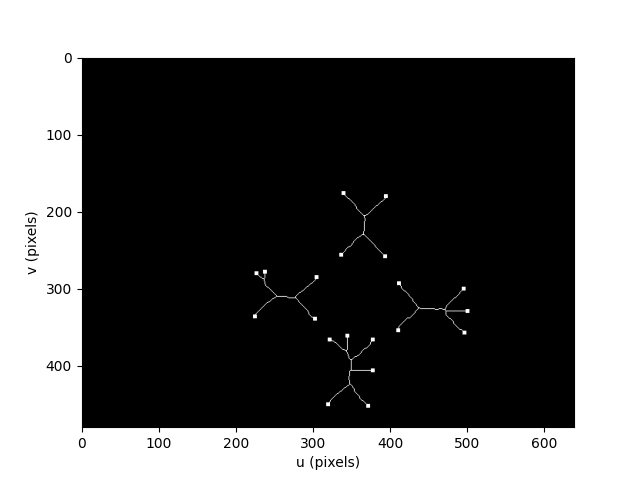

In [ ]:
ends = skeleton.endpoint() #: Определяет конечные точки скелета, то есть точки,
#которые являются "концами" линий скелета. Это важно для анализа структуры объектов,
#например, для понимания, сколько "ветвей" имеет объект.

#
(skeleton + ends.dilate(np.ones((3,3)), n=2)).disp() # use morphology to make the points bigger and more visible
#ends.dilate(np.ones((3,3)), n=2): Применяет операцию дилатации к конечным точкам скелета
#с использованием структурирующего элемента размером 3x3, чтобы сделать эти точки более заметными на изображении.
#Параметр n=2 может указывать на количество итераций дилатации.

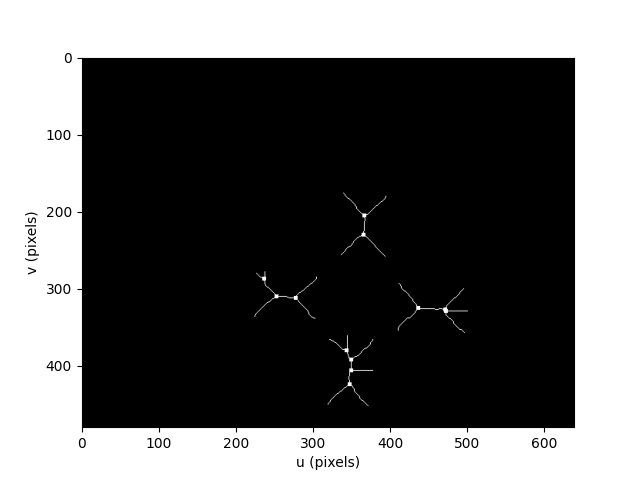

In [ ]:
joins = skeleton.triplepoint();
#skeleton.triplepoint(): Определяет точки соединения (или узловые точки) на скелете,
#где встречаются три и более линии. Эти точки важны для понимания структуры скелета,
#поскольку они указывают на места разветвления или соединения различных частей объекта.

#Визуализация точек соединения
(skeleton + joins.dilate(np.ones((3,3)), n=2)).disp() # use morphology to make the points bigger and more visible
#Аналогично визуализации конечных точек, применяется дилатация к точкам соединения
#с целью сделать их более заметными на скелете.
#Результат дилатации точек соединения сложен с исходным скелетом и отображен,
#позволяя визуально оценить структуру скелета с акцентом на точках соединения.

## 11.6.4 Distance Transform


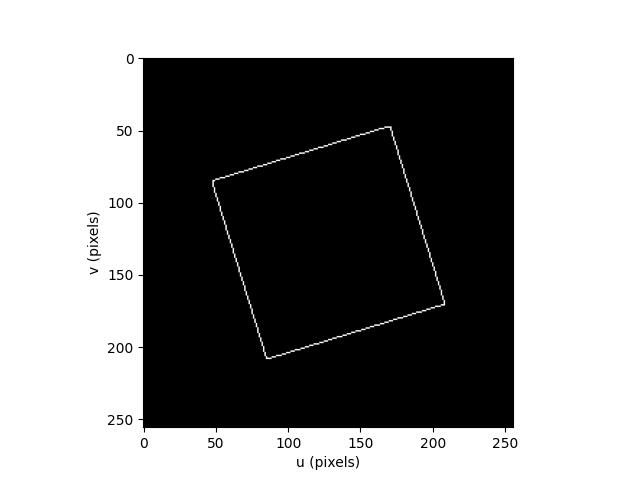

In [ ]:
im.disp()

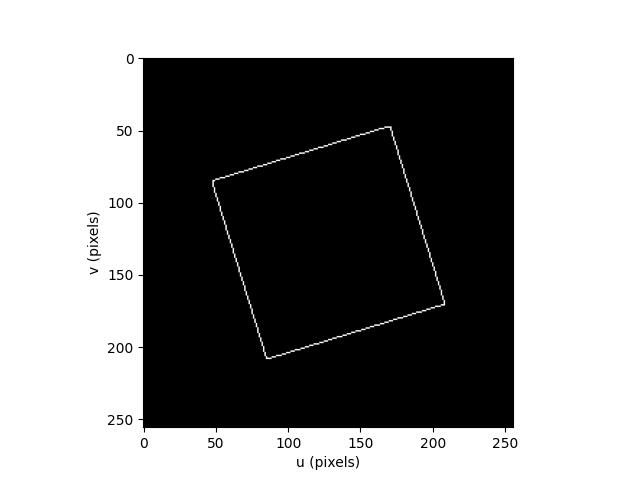

In [ ]:
im = Image.Squares(1, size=256).rotate(0.3).canny()
  #Image.Squares(1, size=256): Создает изображение с квадратами.
  #Аргумент 1 указывает на количество квадратов, а size=256 задает размер изображения.
     #.rotate(0.3): Применяет вращение к изображению.
     #Значение 0.3 указывает угол вращения в радианах (не градусах),
     #что слегка поворачивает изображение и добавляет визуальный интерес.
        #.canny(): Применяет детектор границ Канни к изображению после его вращения.
        #Это преобразует изображение в бинарное, где границы объектов выделены.
           #im.disp(): Отображает обработанное изображение,
           #позволяя визуально оценить результат применения детектора границ Канни.
im.disp()

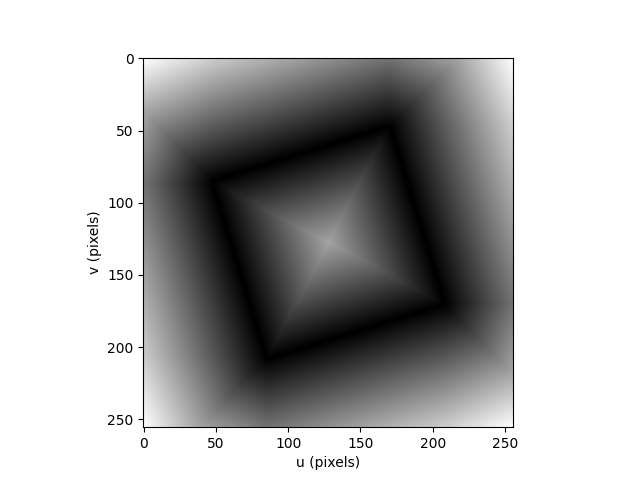

In [ ]:
#Применение преобразования расстояния
dx = im.distance_transform(norm="L2")
   #im.distance_transform(norm="L2"): Выполняет преобразование расстояния на изображении im,
   #используя евклидову норму (L2) для вычисления расстояния.
   #Преобразование расстояния вычисляет для каждого пикселя минимальное расстояние до ближайшей границы
   #(пикселя границы, выделенного детектором Канни).
   #Результатом является новое изображение, где значение каждого пикселя отражает это минимальное расстояние.
      #dx.disp(): Отображает изображение после применения преобразования расстояния.
      #На полученном изображении более светлые области ближе к границам объектов,
      #а темные области дальше от них. Это предоставляет визуальное представление о распределении
      #расстояний до ближайших границ внутри изображения.
dx.disp()

Общее объяснение
Преобразование расстояния предоставляет ценную информацию о структуре изображения, позволяя определить "глубину" каждой области относительно ее ближайших границ. Это может быть использовано для различных целей, включая уточнение границ объектов, сегментацию на основе расстояния, а также в задачах планирования пути и распознавания форм, где важно понимание структуры пространства вокруг объектов на изображении.

# 11.7 Shape Changing
## 11.7.1 Cropping


In [ ]:
mona.disp();

We can't do the next cell from inside Jupyter

In [ ]:
# Select a region of interest on the image, left click then drag
# eyes, roi = mona.roi();
# eyes
# roi

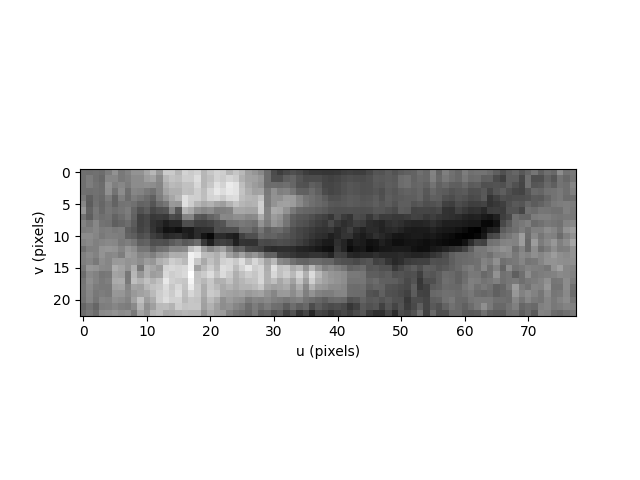

In [ ]:
smile = mona.roi([265, 342, 264, 286]) #Выбирает область интереса (ROI) на изображении mona с использованием координат,
                                       #заданных в массиве
smile.disp();

## 11.7.2 Image Resizing


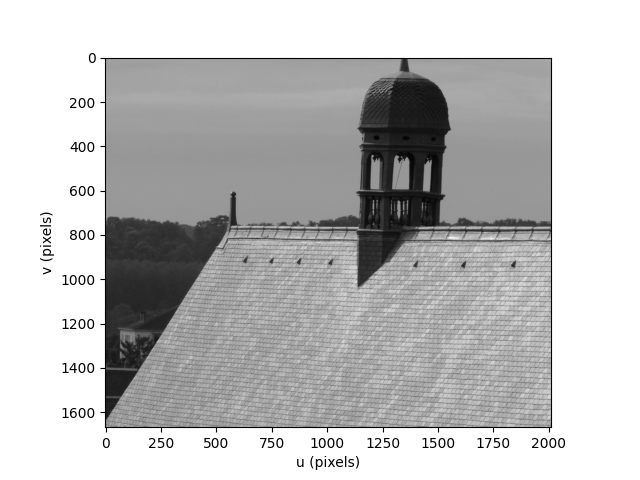

In [ ]:
roof = Image.Read("roof.png", mono=True)
roof.disp()

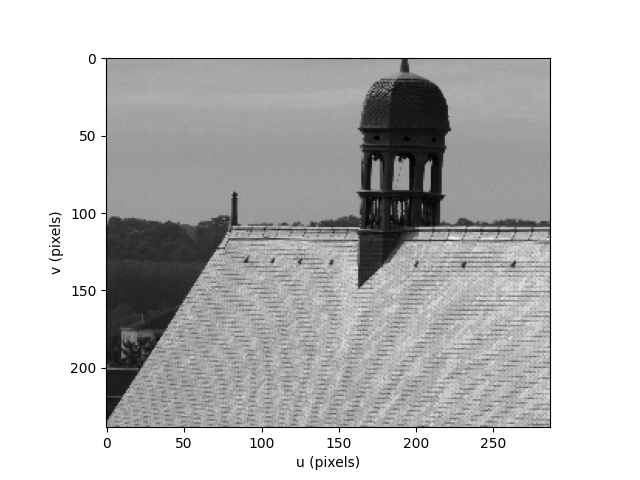

In [ ]:
#Прямое уменьшение размера изображения
roof[::7, ::7].disp(); #Изменяет размер изображения, выбирая каждый седьмой пиксель по горизонтали и вертикали.
                       #Это простой метод уменьшения размера изображения, который может привести к потере важных
                       #деталей и появлению артефактов (например, эффекта муара) из-за пропуска большого количества пикселей.

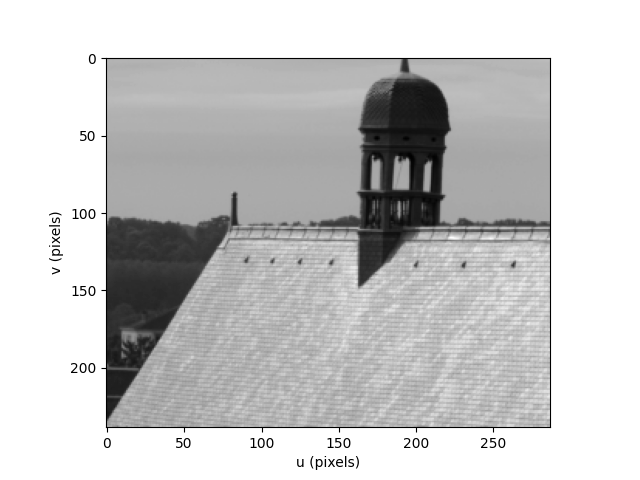

In [ ]:
#Уменьшение размера с предварительным сглаживанием
roof.smooth(sigma=3)[::7, ::7].disp();
                                        #roof.smooth(sigma=3): Применяет Гауссово сглаживание к изображению
                                        #перед уменьшением его размера. Параметр sigma=3 контролирует степень размытия.
                                        #Сглаживание помогает уменьшить визуальные артефакты и потерю деталей
                                        #при последующем уменьшении размера.
                                           #[::7, ::7]: Снова выбирает каждый седьмой пиксель, но уже после
                                           #применения сглаживания.


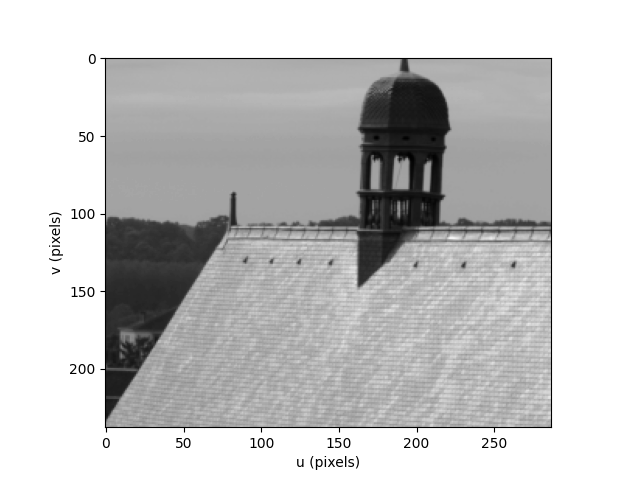

In [ ]:
smaller = roof.scale(1/7, sigma=3) #roof.scale(1/7, sigma=3): Уменьшает размер изображения в 7 раз с предварительным
                                   #применением Гауссова сглаживания (sigma=3). Этот метод более продвинутый по
                                   #сравнению с простым выбором каждого седьмого пикселя, поскольку он может использовать
                                   #интерполяцию для более аккуратного уменьшения размера.
                                      #smaller.replicate(7): Увеличивает размер уменьшенного изображения обратно,
                                      #повторяя каждый пиксель 7 раз по каждому измерению. Это приводит к увеличению
                                      #изображения без попытки восстановить утраченные при уменьшении детали.
smaller.disp()

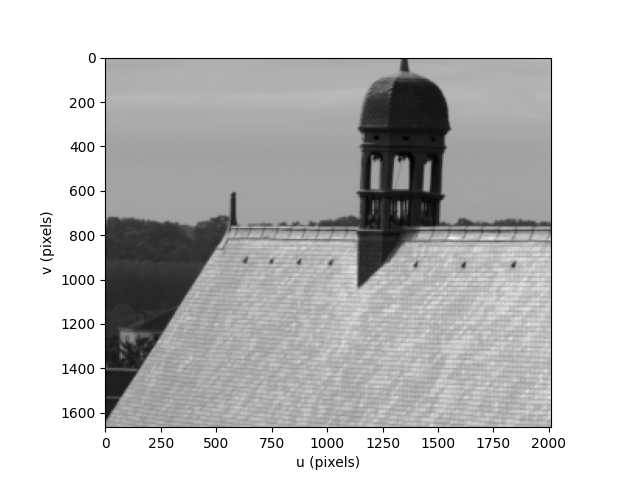

In [ ]:
smaller.replicate(7).disp();
                                      #smaller.replicate(7): Увеличивает размер уменьшенного изображения обратно,
                                      #повторяя каждый пиксель 7 раз по каждому измерению. Это приводит к увеличению
                                      #изображения без попытки восстановить утраченные при уменьшении детали.

## 11.7.3 Image Pyramids


In [ ]:
pyramid = mona.pyramid()
len(pyramid) # Возвращает количество уровней в пирамиде изображений.
#Создание пирамиды изображений из mona. Пирамида изображений — это коллекция изображений,
#где каждое последующее изображение представляет собой уменьшенную версию предыдущего.
#Это позволяет эффективно работать с изображениями на разных уровнях детализации.

11

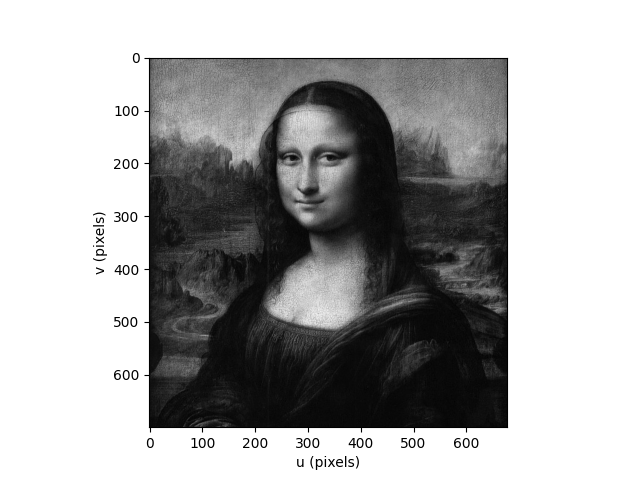

In [ ]:
pyramid[0].disp() #Отображение самого верхнего уровня пирамиды, который соответствует исходному изображению.

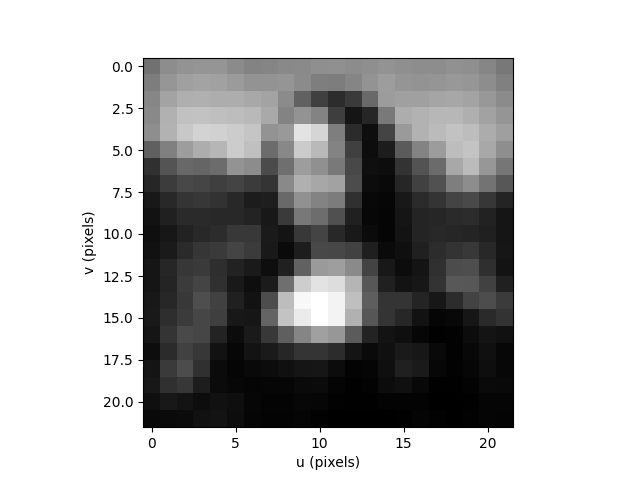

In [ ]:
pyramid[5].disp() #Отображение изображения с более низкого уровня пирамиды, которое является существенно уменьшенной версией исходного изображения.

## 11.7.4 Image Warping


In [ ]:

#Создание сетки координат
Up, Vp = Image.meshgrid(width=500, height=500)
   #Image.meshgrid(width=500, height=500): Создает двумерные массивы координат Up и Vp
   #для изображения размером 500x500 пикселей. Эти массивы используются для определения
   #новых положений пикселей в процессе деформации изображения.

In [ ]:
print(Vp)

[[  0   0   0 ...   0   0   0]
 [  1   1   1 ...   1   1   1]
 [  2   2   2 ...   2   2   2]
 ...
 [497 497 497 ... 497 497 497]
 [498 498 498 ... 498 498 498]
 [499 499 499 ... 499 499 499]]


In [ ]:
#Модификация координат для деформации
U = 4 * (Up - 100);
V = 4 * (Vp - 200);
   #Здесь происходит модификация координат сетки для создания эффекта деформации.
   #Умножение на 4 и вычитание констант изменяют распределение координат, что приведет
   #к деформации изображения при применении этих координат.

Матрицы U и V создаются с целью определения, как каждая точка изображения должна быть перемещена в процессе деформации. Операции, которые были применены к Up и Vp для получения U и V (U = 4 * (Up - 100); V = 4 * (Vp - 200);), задают конкретный вид деформации. Извлекая значения из U и V для конкретных точек, можно понять, как эти точки будут перемещены в результате деформации изображения. Это важно для алгоритмов обработки изображений, где необходимо изменить форму или перспективу изображения для достижения определенных целей анализа или визуализации.

In [ ]:
#Определение точек
p = (300, 200);  # (v, u)
   #Здесь задается точка p с координатами (300, 200), где первое значение соответствует
   #v (обычно вертикальная координата или ось Y), а второе — u (горизонтальная координата или ось X).

#Извлечение значений из матриц U и V
(U[p], V[p])
   #Эта операция извлекает значения из матриц U и V в заданной точке p.
   #Матрицы U и V представляют собой преобразованные координаты,
   #которые используются для деформации изображения. Извлечение значений позволяет увидеть,
   #как координаты точки (300, 200) были преобразованы в результате применения операций к Up и Vp.

(400, 400)

In [ ]:
#Повторение для другой точки
p = (100, 200);  # (v, u)
   #Аналогично первому шагу, задается новая точка p с координатами (100, 200)
   #и извлекаются соответствующие значения из матриц U и V. Это демонстрирует,
   #как преобразованные координаты изменяются для разных точек изображения.
(U[p], V[p])
   #

(400, -400)

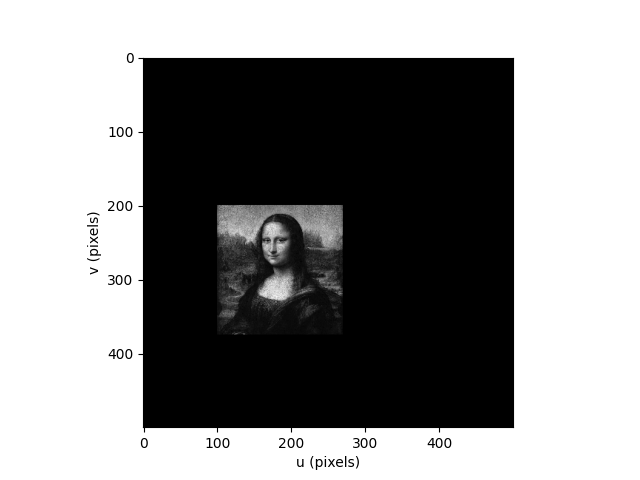

In [ ]:
mona.warp(U, V).disp(); #mona.warp(U, V): Применяет деформацию к изображению mona,
                        #используя модифицированные координаты U и V. Это приводит к изменению положений
                        #пикселей в соответствии с новыми координатами, создавая эффект деформации на изображении.

In [ ]:
#Применение аффинных преобразований
M = np.diag([0.25, 0.25, 1]) * SE2(100, 200)
   #Создается матрица аффинного преобразования M, которая используется для масштабирования
   #изображения и его смещения. np.diag([0.25, 0.25, 1]) создает матрицу масштабирования,
   #а SE2(100, 200) добавляет смещение.

array([[    0.25,        0,       25],
       [       0,     0.25,       50],
       [       0,        0,        1]])

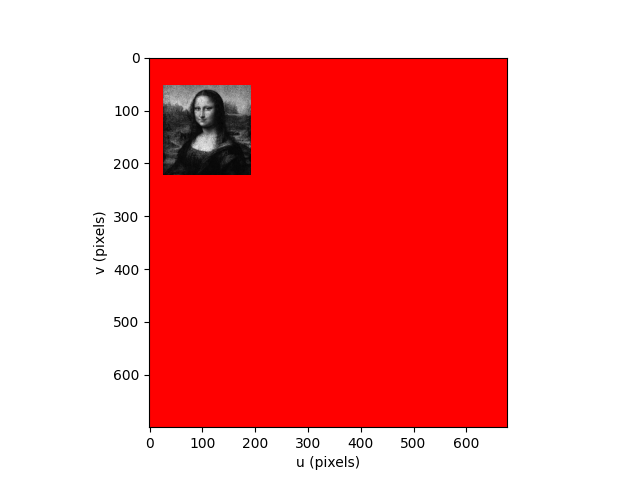

In [ ]:
out = mona.warp_affine(M, bgcolor=np.nan);
   #mona.warp_affine(M, bgcolor=np.nan): Применяет аффинное преобразование к mona,
   #используя матрицу M. Параметр bgcolor=np.nan указывает на цвет фона для пикселей,
   #которые не имеют соответствия на исходном изображении.
out.disp(badcolor="r");

In [ ]:
S = Twist2.UnitRevolute(mona.centre)
#Twist2.UnitRevolute(mona.centre) создает "винтовое" преобразование вокруг центра
#изображения mona. S.exp(pi / 6) генерирует матрицу аффинного преобразования для вращения на угол π/6.

(349.5 -338; 1)

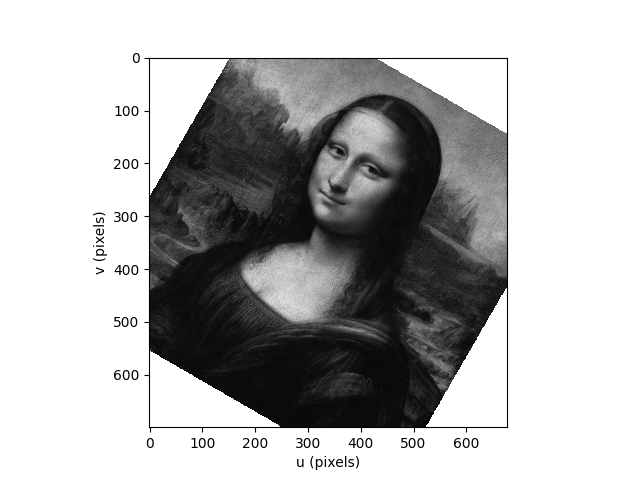

In [ ]:
M = S.exp(pi / 6)
      #S.exp(pi / 6): Создает матрицу аффинного преобразования,
      #используя экспоненциальное отображение вращательной группы SE(2),
      #что соответствует повороту на угол π/6 радиан (или 30 градусов).
      #Это часть процесса создания искажения, при котором изображение не только поворачивается,
      #но и может быть масштабировано или сдвинуто в процессе применения аффинного преобразования.

out = mona.warp_affine(M, bgcolor=np.nan)
        #mona.warp_affine(M, bgcolor=np.nan): Применяет аффинное преобразование,
        #заданное матрицей M, к изображению mona. Параметр
          #bgcolor=np.nan указывает на то, что фон, который может появиться в результате
          #преобразования из-за сдвига пикселей, будет заполнен "прозрачным" цветом или не будет заполнен вовсе.
out.disp()

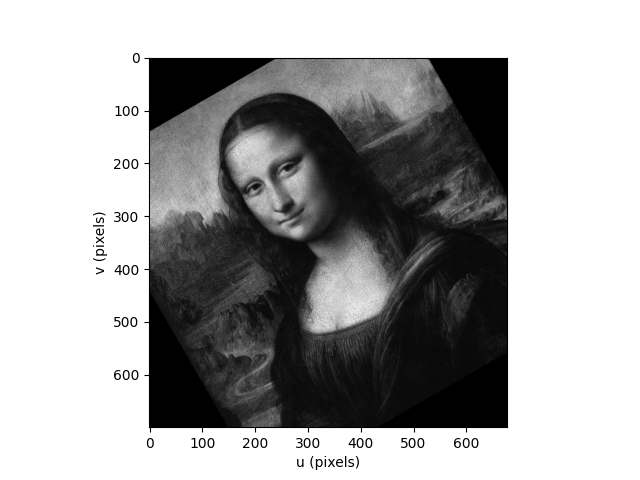

In [ ]:
#Поворот изображения для сравнения
twisted_mona = mona.rotate(pi/6);
    #mona.rotate(pi/6): Выполняет простой поворот изображения mona на угол π/6 радиан (30 градусов)
    #вокруг центра изображения. Это демонстрирует альтернативный способ изменения ориентации
    #изображения без применения аффинного преобразования.
twisted_mona.disp();